# Description

In this investigation we will analyze influence of BPG compression of noisy image at OOP and it's classification accuracy.

All images are gathered in folder ./Images/OOP+BPG

SS1.bmp  
SS2.bmp  
<!-- decompressed_q29_sigma_100_img_1.png  
decompressed_q29_sigma_100_img_2.png  
decompressed_q29_sigma_25_img_1.png  
decompressed_q29_sigma_25_img_2.png  
decompressed_q29_sigma_50_img_1.png  
decompressed_q29_sigma_50_img_2.png  
decompressed_q33_sigma_100_img_1.png  
decompressed_q33_sigma_100_img_2.png  
decompressed_q33_sigma_25_img_1.png  
decompressed_q33_sigma_25_img_2.png  
decompressed_q33_sigma_50_img_1.png  
decompressed_q33_sigma_50_img_2.png   -->
reconstructed_q31_sigma_100_img_1.png  
reconstructed_q31_sigma_50_img_1.png  
reconstructed_q31_sigma_25_img_1.png  
reconstructed_q31_sigma_100_img_2.png  
reconstructed_q31_sigma_50_img_2.png  
reconstructed_q31_sigma_25_img_2.png  

reconstructed_q35_sigma_100_img_1.png  
reconstructed_q35_sigma_50_img_1.png  
reconstructed_q35_sigma_25_img_1.png  
reconstructed_q35_sigma_100_img_2.png  
reconstructed_q35_sigma_50_img_2.png  
reconstructed_q35_sigma_25_img_2.png  

noisy_sigma_100_img_1.bmp  
noisy_sigma_100_img_2.bmp  
noisy_sigma_25_img_1.bmp  
noisy_sigma_25_img_2.bmp  
noisy_sigma_50_img_1.bmp  
noisy_sigma_50_img_2.bmp   

For classificator based on XGBoost and LBP we are going to use the following values

| Rank | n_estimators | max_depth | eta  | radius | n_points |
|------|--------------|-----------|------|--------|----------|
| 1    | 500          | 4         | 0.30 | 3      | 16       |

#### Importing the Necessary Libraries

The main ones here are XGBoost and local_binary_pattern.

In [115]:
import numpy as np
import cv2
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import xgboost as xgb
import random
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
from skimage.feature import local_binary_pattern
import time

In [116]:
import warnings
# Вимкнути всі попередження для видаленн зайвої інформації з консолі
warnings.filterwarnings('ignore')

#### Feature Extraction Functions

LBP focuses on texture, so adding color information can significantly enhance the classifier's capabilities.  
In this study, RGB channel pixel values will be added to the LBP features.

In [117]:
def prepare_data_with_colored_mask(image, mask, color_to_class, pixel_sample_percentage):
    """
    Selects coordinates and labels from a colored mask for training and generates a mask for the training pixels.
    
    Parameters:
        image: Input RGB image.
        mask: Input colored mask (BGR) indicating class labels.
        color_to_class: Dictionary mapping mask colors to class indices.
        pixel_sample_percentage: Percentage of pixels to select for the training subset.
    
    Returns:
        sampled_coordinates: List of coordinates [(y, x)] of the selected pixels.
        sampled_labels: List of class labels for the selected pixels.
        temp_training_mask: Temporary mask containing only the pixels used for training.
    """
    coordinates = []
    labels = []
    
    # Initialize an empty mask for visualizing training pixels
    training_mask = np.ones_like(mask) * 255  # The mask is initially white (unused pixels)
    
    # Iterate through the input mask pixels
    for y in range(mask.shape[0]):
        for x in range(mask.shape[1]):
            b, g, r = mask[y, x]  # OpenCV uses BGR format
            color = (r, g, b)
            if color in color_to_class:
                coordinates.append((y, x))
                labels.append(color_to_class[color])
                # Copy colors from the original mask into the temporary mask
                training_mask[y, x] = mask[y, x]
            elif color == (255, 255, 255):  # Ignore white pixels
                continue

    # Shuffle and sample pixels
    combined = list(zip(coordinates, labels))
    random.shuffle(combined)
    coordinates, labels = zip(*combined)
    
    # Select a subset of pixels for training
    sample_size = int(len(coordinates) * pixel_sample_percentage)
    sampled_coordinates = coordinates[:sample_size]
    sampled_labels = labels[:sample_size]
    
    # Modify training_mask to retain only the sampled subset
    temp_training_mask = np.ones_like(mask) * 255  # Create a new mask with a white background
    for (y, x) in sampled_coordinates:
        temp_training_mask[y, x] = mask[y, x]  # Copy only the sampled coordinates
    
    # Return results
    return sampled_coordinates, sampled_labels, temp_training_mask

In [118]:
def extract_pixel_features_rgb_with_lbp_and_colors(image, coordinates, radius=1, n_points=16, method='uniform'):
    """
    Extract LBP features and RGB values for each pixel coordinate.
    
    Parameters:
        image: RGB input image.
        coordinates: List of pixel coordinates [(y1, x1), (y2, x2), ...].
        radius: Radius for the LBP descriptor.
        n_points: Number of sampling points for the LBP descriptor.
        method: LBP calculation method ('uniform', 'default', etc.).
    
    Returns:
        np.array: Feature vectors for each pixel.
    """
    features = []
    b_channel, g_channel, r_channel = cv2.split(image)

    for coord in coordinates:
        y, x = coord
        lbp_features = []
        for channel in [b_channel, g_channel, r_channel]:
            patch = channel[max(0, y - radius):min(channel.shape[0], y + radius + 1),
                            max(0, x - radius):min(channel.shape[1], x + radius + 1)]
            if patch.shape[0] < 2 * radius + 1 or patch.shape[1] < 2 * radius + 1:
                patch = cv2.resize(patch, (2 * radius + 1, 2 * radius + 1))
            lbp = local_binary_pattern(patch, P=n_points, R=radius, method=method)
            lbp_features.extend(lbp.flatten())

        rgb_values = [r_channel[y, x], g_channel[y, x], b_channel[y, x]]
        feature_vector = np.concatenate((lbp_features, rgb_values))
        features.append(feature_vector)

    return np.array(features)

### Model Training

We will use the standard training approach, where the training data is split into two parts: training data and validation data.  
Unlike the previous study LBP+Color+XGBoost per-pixel Sentinel, this function is capable of accepting more input parameters, allowing us to run a loop with varying parameters for their evaluation.

In [119]:
def train_xgboost_classifier(features, labels, n_estimators=500, max_depth=4, eta=0.3):
    """
    Train an XGBoost classifier.
    
    Parameters:
        features: Feature matrix (N x M, where M is the feature size).
        labels: Corresponding labels (N x 1).
    
    Returns:
        Trained XGBoost model.
    """
    X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.3, random_state=42)

    model = xgb.XGBClassifier(
        objective='multi:softmax',
        num_class=4,
        n_estimators=n_estimators,
        max_depth=max_depth,
        eta=eta
    )
    
    model.fit(X_train, y_train)
    
    # Evaluate model performance
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    print(f"Accuracy: {accuracy * 100:.2f}%")
    print("Classification Report:")
    print(classification_report(y_test, y_pred))
    
    return model

### Classification Function

This function implements the ability to evaluate the model on images different from those used for its training and validation.

In [120]:
def classify_entire_image(image, model, radius=1, n_points=8, class_to_color=None, expected_size=None, use_color=True, use_lbp=True):
    """
    Classify each pixel in the input image using the trained model with support for LBP, RGB, or LBP+RGB features.

    Parameters:
        image: Input RGB image.
        model: Trained XGBoost model or any compatible classifier.
        radius: Radius for the LBP descriptor.
        n_points: Number of sampling points for the LBP descriptor.
        class_to_color: Mapping of class indices to RGB colors.
        expected_size: Expected size of feature vectors for inference (must match training).
        use_color: Whether to include RGB color values in the feature vector (True to include RGB).
        use_lbp: Whether to include LBP features in the feature vector (True to include LBP).

    Returns:
        full_mask: Output classification mask (RGB image).
    """
    height, width = image.shape[:2]
    full_mask = np.zeros((height, width, 3), dtype=np.uint8)

    # Loop through each pixel and classify
    for y in range(height):
        for x in range(width):
            feature_vector = []  # This will store both LBP and/or RGB features based on settings

            # Extract LBP features if enabled
            if use_lbp:
                lbp_features = []
                for channel in cv2.split(image):
                    # Extract local patch around the pixel
                    patch = channel[max(0, y - radius):min(channel.shape[0], y + radius + 1),
                                    max(0, x - radius):min(channel.shape[1], x + radius + 1)]
                    if patch.shape[0] < 2 * radius + 1 or patch.shape[1] < 2 * radius + 1:
                        patch = cv2.resize(patch, (2 * radius + 1, 2 * radius + 1))
                    # Compute LBP for the local patch
                    lbp = local_binary_pattern(patch, P=n_points, R=radius, method='uniform')
                    lbp_features.extend(lbp.flatten())  # Append LBP features for the channel
                feature_vector.extend(lbp_features)  # Add LBP features to the feature vector

            # Extract color features if enabled
            if use_color:
                rgb_values = [image[y, x, 2], image[y, x, 1], image[y, x, 0]]  # RGB order
                feature_vector.extend(rgb_values)  # Add RGB values to the feature vector

            # Convert feature vector to np.array
            feature_vector = np.array(feature_vector)

            # Ensure feature vector size matches the expected size for the model
            if expected_size is None:
                # Retrieve the expected size from the model
                expected_size = len(model.feature_names_in_)
            if feature_vector.shape[0] != expected_size:
                if feature_vector.shape[0] < expected_size:
                    feature_vector = np.pad(feature_vector, (0, expected_size - feature_vector.shape[0]), mode='constant')
                elif feature_vector.shape[0] > expected_size:
                    feature_vector = feature_vector[:expected_size]  # Truncate features if too large

            # Run prediction for the pixel
            prediction = model.predict(np.array([feature_vector]))[0]
            # Map the prediction to the corresponding color
            full_mask[y, x] = class_to_color[prediction]

    return full_mask

### Separate Function for Model Evaluation

This function evaluates the classification accuracy based on the provided mask.  
It enables a clean experiment where the data used for training and validating the model differs from the data used for evaluating the model.

In [121]:
def evaluate_classification_results(resulting_mask, eval_mask, color_to_class):
    """
    Оцінює точність класифікації на основі повної маски для оцінки.

    Parameters:
        resulting_mask: Класифікована маска (BGR).
        eval_mask: Маска для оцінки точності (BGR).
        color_to_class: Словник, що встановлює відповідність кольорів класам.

    Returns:
        accuracy: Точність класифікації.
        report: Повний звіт класифікації.
    """
    eval_labels = []
    predicted_labels = []
    
    # Білий колір (зазвичай ігноровані пікселі)
    ignored_color = (255, 255, 255)  # Білий у форматі BGR

    # Проходимо через пікселі оцінкової маски
    for y in range(eval_mask.shape[0]):
        for x in range(eval_mask.shape[1]):
            eval_color = tuple(eval_mask[y, x])  # BGR формат
            predicted_color = tuple(resulting_mask[y, x])  # BGR формат

            # Ігнорувати пікселі білого кольору
            if eval_color == ignored_color:
                continue

            # Перевіряємо, чи кольори присутні в словнику для оцінки
            if eval_color in color_to_class:
                eval_labels.append(color_to_class[eval_color])
            else:
                print(f"Warning: eval_color {eval_color} не знайдено в color_to_class.")
                continue  # Пропускаємо, якщо eval_color немає в словнику
                
            if predicted_color in color_to_class:
                predicted_labels.append(color_to_class[predicted_color])
            else:
                print(f"Warning: predicted_color {predicted_color} не знайдено в color_to_class.")
                continue  # Пропускаємо, якщо predicted_color немає в словнику

    # Якщо після всіх перевірок немає пікселів для обчислення, повернемо нульові значення
    if len(eval_labels) == 0 or len(predicted_labels) == 0:
        print("Warning: У обраній області немає відповідних пікселів для оцінки.")
        return 0.0, "No data available for evaluation."

    # Використовуємо sklearn для оцінки точності
    accuracy = accuracy_score(eval_labels, predicted_labels)
    report = classification_report(eval_labels, predicted_labels, output_dict=True, zero_division=0)
    
    return accuracy, report

#### Define classification process as separate function

In [122]:
# Helper function to preprocess metrics from classification_report
def preprocess_report(report):
    processed_report = {}
    for key, value in report.items():
        if isinstance(value, dict):  # Recursively process sub-dictionaries
            processed_report[key] = {
                metric: (float(v) if metric != "support" else int(v))
                for metric, v in value.items()
            }
        else:
            # For `accuracy` or similar top-level metrics
            processed_report[key] = float(value)
    return processed_report

In [140]:
def process_sigma_case(case, sigma, train_image_path, train_mask_path, eval_mask_path, validation_image_paths):
    """
    Processes one training image for a given case (SS1/SS2) and sigma^2.
    Trains a model with the specified training image, then validates on all images in validation_image_paths.

    Parameters:
        train_image_path: Path to the specific training image.
        train_mask_path: Path to the mask for training.
        eval_mask_path: Path to the evaluation mask for accuracy comparison.
        validation_image_paths: List of paths to images for validation.

    Returns:
        List[dict]: A list of dictionaries containing F1-scores and metadata for classification results.
    """
    # Print debug information
    print(f"\nTraining model using {train_image_path}")

    # Start time for the process
    process_start_time = time.perf_counter()

    # Load training image and mask
    train_image = cv2.imread(train_image_path, cv2.IMREAD_COLOR)
    if train_image is None:
        raise FileNotFoundError(f"Training image not found: {train_image_path}")
    train_mask = cv2.imread(train_mask_path, cv2.IMREAD_COLOR)
    if train_mask is None:
        raise FileNotFoundError(f"Training mask not found: {train_mask_path}")
    eval_mask = cv2.imread(eval_mask_path, cv2.IMREAD_COLOR)
    if eval_mask is None:
        raise FileNotFoundError(f"Evaluation mask not found: {eval_mask_path}")
    eval_mask_rgb = cv2.cvtColor(eval_mask, cv2.COLOR_BGR2RGB)

    # Color-to-class mapping
    color_to_class = {
        (0, 0, 255): 0,    # Blue - Water
        (0, 255, 0): 1,    # Green - Vegetation
        (0, 0, 0): 2,      # Black - Open Ground
        (255, 255, 0): 3   # Yellow - Urbanization
    }

    class_to_color = {v: k for k, v in color_to_class.items()}  # Reverse mapping for visualization

    # === Sampling Features and Labels ===
    sampled_coordinates, sampled_labels, training_mask = prepare_data_with_colored_mask(
        train_image, train_mask, color_to_class, pixel_sample_percentage=1.0
    )

    # Visualize training mask alongside the evaluation mask
    training_mask_rgb = cv2.cvtColor(training_mask, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(16, 8))
    plt.subplot(1, 2, 1)
    plt.imshow(training_mask_rgb)
    plt.axis('off')
    plt.title(f"Training Mask ({train_image_path.split('/')[-1]})")

    plt.subplot(1, 2, 2)
    plt.imshow(eval_mask_rgb)
    plt.axis('off')
    plt.title("Validation Mask")
    plt.tight_layout()
    plt.show()

    # Save training and validation masks to confirm accuracy later
    cv2.imwrite("Images/temp/training_mask.png", training_mask)
    cv2.imwrite("Images/temp/eval_mask.png", eval_mask)

    # === Extract Features and Train Model ===
    features = extract_pixel_features_rgb_with_lbp_and_colors(
        train_image, sampled_coordinates, radius=1, n_points=8
    )

    # Train the XGBoost model
    model = train_xgboost_classifier(features, sampled_labels)

    # Debug: Confirm training completion
    print(f"Model trained with: {train_image_path.split('/')[-1]}")

    # === Validate on Each Validation Image ===
    classification_results = []

    for validation_image_path in validation_image_paths:
        # Debug: Print validation message
        print(f"Image to classify is {validation_image_path.split('/')[-1]}")

        validation_image = cv2.imread(validation_image_path, cv2.IMREAD_COLOR)
        if validation_image is None:
            print(f"Error: Validation image not found or unreadable: {validation_image_path}")
            continue  # Skip this validation image
        
        # Perform classification
        resulting_mask = classify_entire_image(
            validation_image, model, radius=1, n_points=8, class_to_color=class_to_color, 
            expected_size=features.shape[1], use_color=True, use_lbp=True
        )

        # Convert for displaying and save classification result
        resulting_mask_rgb = cv2.cvtColor(resulting_mask, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(8, 8))
        plt.imshow(resulting_mask)
        plt.axis('off')
        plt.title(f"Resulting Mask for {validation_image_path}")
        plt.show()

        # Save classification mask
        output_path = f"Images/temp/result_colored_mask_{validation_image_path.split('/')[-1]}"
        cv2.imwrite(output_path, resulting_mask_rgb)
        print(f"Result saved to: {output_path}")

        # Evaluate classification accuracy
        accuracy, report = evaluate_classification_results(
            resulting_mask, eval_mask_rgb, color_to_class
        )

        # Preprocess report to ensure precision, recall, etc., are numeric
        report = preprocess_report(report)

        # Output formatted accuracy and classification report
        print(f"Evaluation Accuracy on Eval Image: {accuracy * 100:.2f}%")
        print("Evaluation Classification Report:")
        print(f"{'Class': <10}{'Precision': <10}{'Recall': <10}{'F1-Score': <10}{'Support': <10}")
        print("-" * 50)

        for class_label in ['0', '1', '2', '3']:
            if class_label in report:
                precision = report[class_label].get('precision', 0.0)
                recall = report[class_label].get('recall', 0.0)
                f1_score = report[class_label].get('f1-score', 0.0)
                support = report[class_label].get('support', 0)
                print(f"{class_label: <10}{precision: <10.2f}{recall: <10.2f}{f1_score: <10.2f}{support: <10}")

        print("\nOverall Metrics:")
        print(f"{'Metric': <10}{'Precision': <10}{'Recall': <10}{'F1-Score': <10}{'Support': <10}")
        print("-" * 50)
        print(f"{'Macro Avg': <10}{report['macro avg']['precision']: <10.2f}{report['macro avg']['recall']: <10.2f}{report['macro avg']['f1-score']: <10.2f}{report['macro avg']['support']: <10}")
        print(f"{'Weighted Avg': <10}{report['weighted avg']['precision']: <10.2f}{report['weighted avg']['recall']: <10.2f}{report['weighted avg']['f1-score']: <10.2f}{report['weighted avg']['support']: <10}")

        # Build the result dictionary
        classification_results.append({
            "Case": case,
            "sigma^2": sigma,
            "Training Image": train_image_path.split('/')[-1],
            "Classified Image": validation_image_path.split('/')[-1],
            "F1-Score class 3": report['3']['f1-score'],
            "F1-Score class 0": report['0']['f1-score'],
            "F1-Score class 1": report['1']['f1-score'],
            "F1-Score class 2": report['2']['f1-score'],
            "F1 Total": report['macro avg']['f1-score'],
        })
    
    process_end_time = time.perf_counter()
    print(f"Time taken for {case}, sigma^2={sigma}, training on {train_image_path.split('/')[-1]}: {process_end_time - process_start_time:.2f} seconds")

    return classification_results

### Main Function

This function utilizes the approach of (LBP + Color) + XGBoost with Sentinel data images.  
It applies Grid Search to iterate through parameters and determine the optimal values for both XGBoost and LBP.  

As part of the research, the evaluation of the optimal configuration will consider the recommended values for LBP while varying only the configuration of XGBoost.  
Additionally, a comparison will be made with the results obtained from a grid search that accounts for changes in both XGBoost and LBP configurations.  

The evaluation will be based on two Sentinel data images (SS1 and SS2).


=== Processing for sigma^2 = 25, Case: SS1 ===

Training model using Images/OOP+BPG/noisy_sigma_25_img_1.bmp


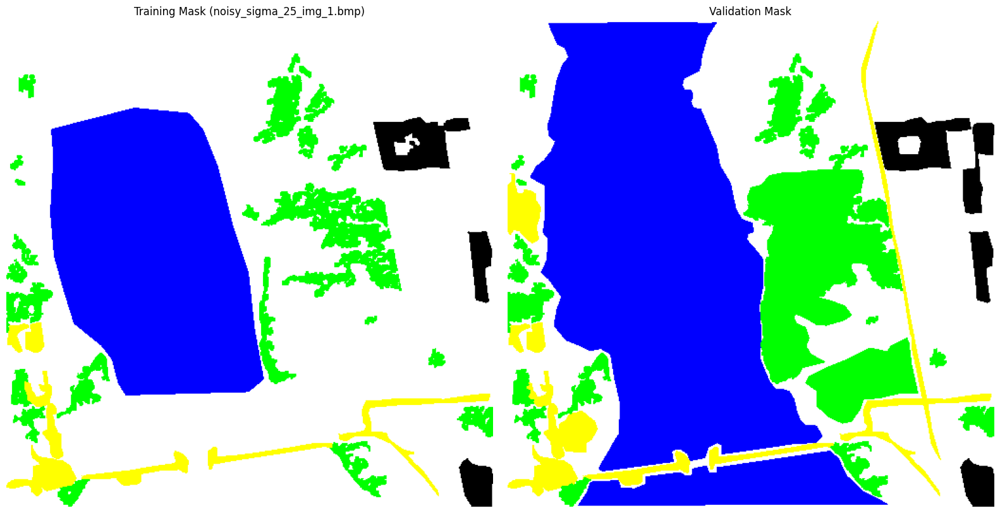

Accuracy: 96.98%
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15650
           1       0.97      0.97      0.97      6035
           2       0.85      0.85      0.85      1884
           3       0.89      0.87      0.88      2226

    accuracy                           0.97     25795
   macro avg       0.92      0.92      0.92     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: noisy_sigma_25_img_1.bmp
Image to classify is noisy_sigma_25_img_1.bmp
Result saved to: Images/temp/result_colored_mask_noisy_sigma_25_img_1.bmp
Image to classify is reconstructed_q35_sigma_25_img_1.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_25_img_1.png
Image to classify is reconstructed_q31_sigma_25_img_1.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_25_img_1.png
Image to classify is reconstructed_q31_sigma_25_img_1.png
Result saved t

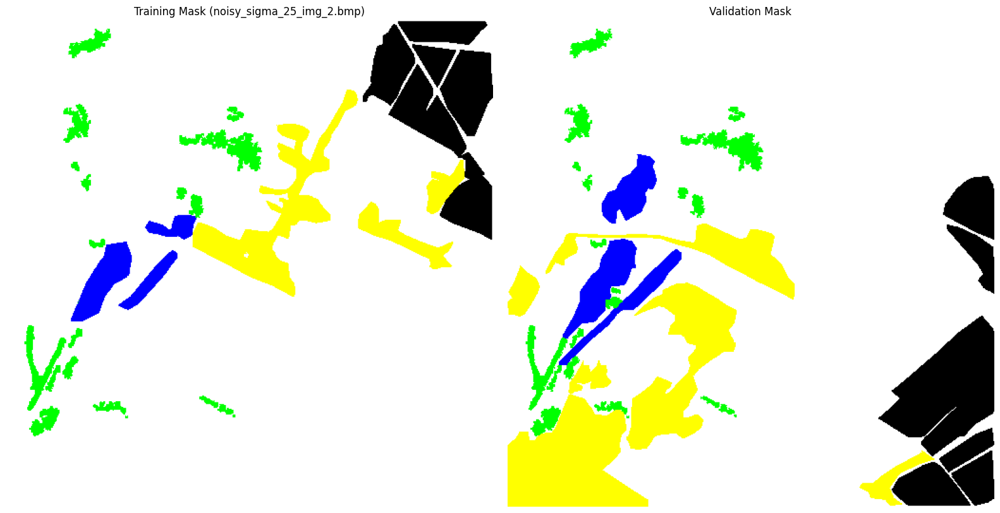

Accuracy: 92.37%
Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.92      0.92      1310
           1       0.85      0.86      0.85      1738
           2       0.94      0.96      0.95      4481
           3       0.94      0.92      0.93      3495

    accuracy                           0.92     11024
   macro avg       0.91      0.91      0.91     11024
weighted avg       0.92      0.92      0.92     11024

Model trained with: noisy_sigma_25_img_2.bmp
Image to classify is noisy_sigma_25_img_2.bmp
Result saved to: Images/temp/result_colored_mask_noisy_sigma_25_img_2.bmp
Image to classify is reconstructed_q35_sigma_25_img_2.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_25_img_2.png
Image to classify is reconstructed_q31_sigma_25_img_2.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_25_img_2.png
Image to classify is reconstructed_q31_sigma_25_img_2.png
Result saved t

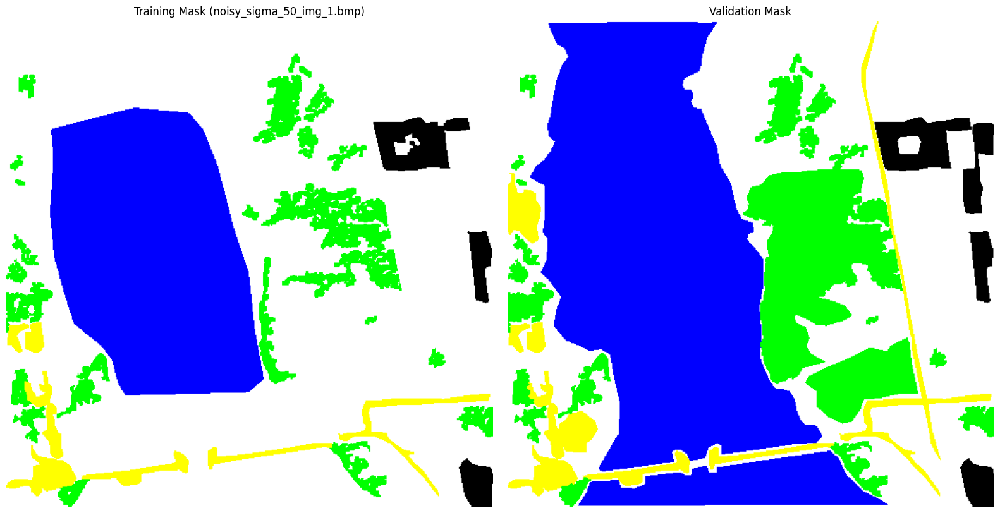

Accuracy: 96.95%
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15597
           1       0.96      0.97      0.97      6007
           2       0.86      0.86      0.86      1949
           3       0.89      0.88      0.88      2242

    accuracy                           0.97     25795
   macro avg       0.93      0.93      0.93     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: noisy_sigma_50_img_1.bmp
Image to classify is noisy_sigma_50_img_1.bmp
Result saved to: Images/temp/result_colored_mask_noisy_sigma_50_img_1.bmp
Image to classify is reconstructed_q35_sigma_50_img_1.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_50_img_1.png
Image to classify is reconstructed_q31_sigma_50_img_1.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_50_img_1.png
Image to classify is reconstructed_q31_sigma_50_img_1.png
Result saved t

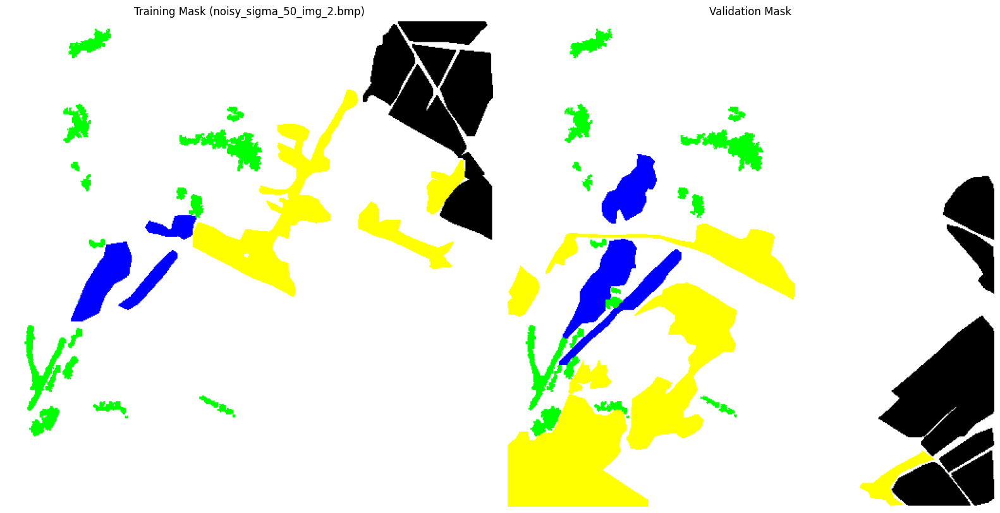

Accuracy: 91.07%
Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.91      0.91      1281
           1       0.83      0.81      0.82      1775
           2       0.93      0.95      0.94      4517
           3       0.93      0.90      0.92      3451

    accuracy                           0.91     11024
   macro avg       0.90      0.90      0.90     11024
weighted avg       0.91      0.91      0.91     11024

Model trained with: noisy_sigma_50_img_2.bmp
Image to classify is noisy_sigma_50_img_2.bmp
Result saved to: Images/temp/result_colored_mask_noisy_sigma_50_img_2.bmp
Image to classify is reconstructed_q35_sigma_50_img_2.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_50_img_2.png
Image to classify is reconstructed_q31_sigma_50_img_2.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_50_img_2.png
Image to classify is reconstructed_q31_sigma_50_img_2.png
Result saved t

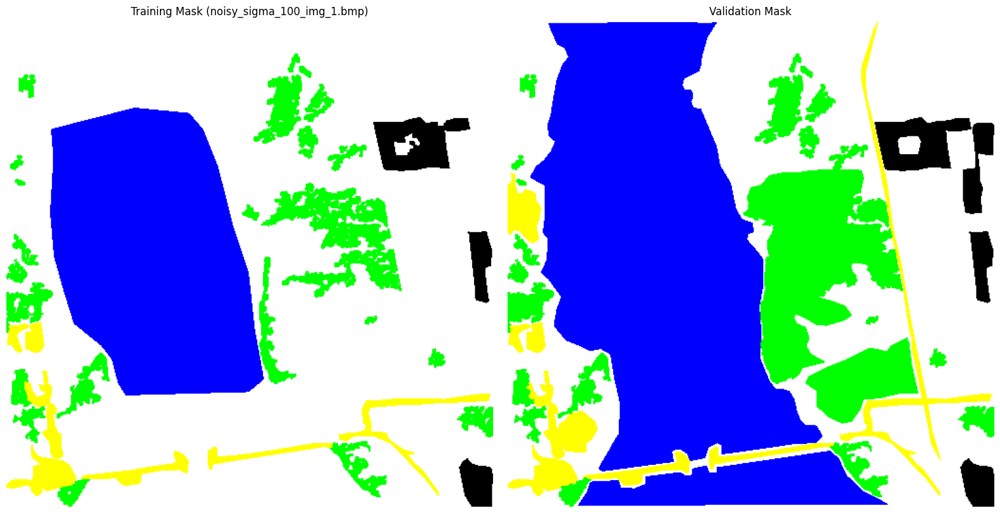

Accuracy: 96.56%
Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     15741
           1       0.96      0.96      0.96      5940
           2       0.84      0.84      0.84      1877
           3       0.89      0.87      0.88      2237

    accuracy                           0.97     25795
   macro avg       0.92      0.92      0.92     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: noisy_sigma_100_img_1.bmp
Image to classify is noisy_sigma_100_img_1.bmp
Result saved to: Images/temp/result_colored_mask_noisy_sigma_100_img_1.bmp
Image to classify is reconstructed_q35_sigma_100_img_1.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_100_img_1.png
Image to classify is reconstructed_q31_sigma_100_img_1.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_100_img_1.png
Image to classify is reconstructed_q31_sigma_100_img_1.png
Result

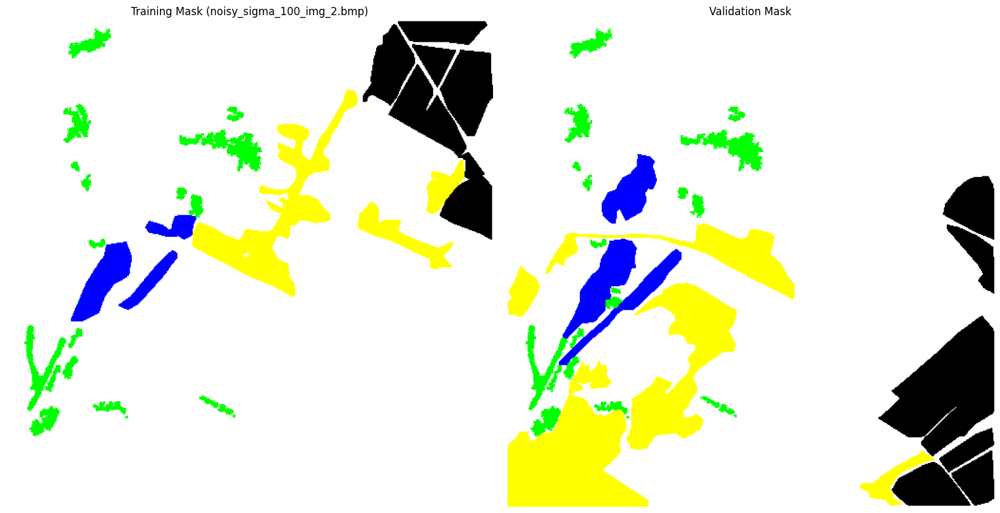

Accuracy: 89.59%
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.89      0.89      1267
           1       0.80      0.78      0.79      1799
           2       0.91      0.94      0.93      4493
           3       0.93      0.90      0.91      3465

    accuracy                           0.90     11024
   macro avg       0.88      0.88      0.88     11024
weighted avg       0.90      0.90      0.90     11024

Model trained with: noisy_sigma_100_img_2.bmp
Image to classify is noisy_sigma_100_img_2.bmp
Result saved to: Images/temp/result_colored_mask_noisy_sigma_100_img_2.bmp
Image to classify is reconstructed_q35_sigma_100_img_2.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_100_img_2.png
Image to classify is reconstructed_q31_sigma_100_img_2.png
Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_100_img_2.png
Image to classify is reconstructed_q31_sigma_100_img_2.png
Result

In [131]:
if __name__ == "__main__":
    # All sigma cases to process
    sigma_values = [25, 50, 100]

    # SS1 and SS2 paths for masks
    ss1_mask_train = "Images/sentinel/SS1/Samples1.bmp"
    ss1_mask_eval = "Images/sentinel/SS1/Etalon1.bmp"

    ss2_mask_train = "Images/sentinel/SS2/Samples2.bmp"
    ss2_mask_eval = "Images/sentinel/SS2/Etalon2.bmp"

    # Store all results
    all_results = []

    for sigma in sigma_values:
        # SS1 Case: Add reconstructed images for training
        print(f"\n=== Processing for sigma^2 = {sigma}, Case: SS1 ===")
        train_image_path_ss1 = f"Images/OOP+BPG/noisy_sigma_{sigma}_img_1.bmp"
        validation_image_paths_ss1 = [
            f"Images/OOP+BPG/noisy_sigma_{sigma}_img_1.bmp",
            f"Images/OOP+BPG/reconstructed_q35_sigma_{sigma}_img_1.png",
            f"Images/OOP+BPG/reconstructed_q31_sigma_{sigma}_img_1.png"
        ]
        # Add reconstructed images for training if sigma=50 or sigma=100
        additional_training_images_ss1 = [
            f"Images/OOP+BPG/reconstructed_q31_sigma_{sigma}_img_1.png",
            f"Images/OOP+BPG/reconstructed_q35_sigma_{sigma}_img_1.png"
        ]

        results_ss1 = process_sigma_case(
            case="SS1",
            sigma=sigma,
            train_image_path=train_image_path_ss1,
            train_mask_path=ss1_mask_train,
            eval_mask_path=ss1_mask_eval,
            validation_image_paths=validation_image_paths_ss1 + additional_training_images_ss1
        )
        all_results.extend(results_ss1)

        # SS2 Case: Add reconstructed images for training
        print(f"\n=== Processing for sigma^2 = {sigma}, Case: SS2 ===")
        train_image_path_ss2 = f"Images/OOP+BPG/noisy_sigma_{sigma}_img_2.bmp"
        validation_image_paths_ss2 = [
            f"Images/OOP+BPG/noisy_sigma_{sigma}_img_2.bmp",
            f"Images/OOP+BPG/reconstructed_q35_sigma_{sigma}_img_2.png",
            f"Images/OOP+BPG/reconstructed_q31_sigma_{sigma}_img_2.png"
        ]
        # Add reconstructed images for training if sigma=50 or sigma=100
        additional_training_images_ss2 = [
            f"Images/OOP+BPG/reconstructed_q31_sigma_{sigma}_img_2.png",
            f"Images/OOP+BPG/reconstructed_q35_sigma_{sigma}_img_2.png"
        ]

        results_ss2 = process_sigma_case(
            case="SS2",
            sigma=sigma,
            train_image_path=train_image_path_ss2,
            train_mask_path=ss2_mask_train,
            eval_mask_path=ss2_mask_eval,
            validation_image_paths=validation_image_paths_ss2 + additional_training_images_ss2
        )
        all_results.extend(results_ss2)

    # Generate tables for results
    print("\n=== Classification Results ===")
    print("| Case | sigma^2 | Training Image        | Classified Image            | F1-Score class 3 | F1-Score class 0 | F1-Score class 1 | F1-Score class 2 | F1 Total |")
    print("|------|---------|-----------------------|-----------------------------|------------------|------------------|------------------|------------------|----------|")

    for result in all_results:
        # Safely retrieve and convert metrics to floats
        try:
            f1_class_3 = float(result.get('F1-Score class 3', 0))
            f1_class_0 = float(result.get('F1-Score class 0', 0))
            f1_class_1 = float(result.get('F1-Score class 1', 0))
            f1_class_2 = float(result.get('F1-Score class 2', 0))
            f1_total = float(result.get('F1 Total', 0))
        except ValueError as e:
            print(f"Error converting results for: {result['Case']} {result['sigma^2']}. Defaulting to 0. Details: {e}")
            f1_class_3, f1_class_0, f1_class_1, f1_class_2, f1_total = 0, 0, 0, 0, 0  # Default fallback values

        print(f"| {result['Case']} | {result['sigma^2']} | {result['Training Image']} | {result['Classified Image']} | "
              f"{f1_class_3:.2f} | {f1_class_0:.2f} | {f1_class_1:.2f} | {f1_class_2:.2f} | {f1_total:.2f} |")

    # Divide results into tables for img_1 and img_2
    img_1_results = [result for result in all_results if 'img_1' in result['Training Image']]
    img_2_results = [result for result in all_results if 'img_2' in result['Training Image']]

    # === Generate Separate Tables ===

    # Table for SS1 Results
    print("\n=== Classification Results for SS1 ===")
    print("| Case | sigma^2 | Training Images                                  | Classified Image                  | F1-Score class 3 | F1-Score class 0 | F1-Score class 1 | F1-Score class 2 | F1 Total |")
    print("|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|")
    
    for result in all_results_ss1:
        try:
            f1_class_3 = float(result.get('F1 class 3 (Urbanization)', 0))
            f1_class_0 = float(result.get('F1 class 0 (Water)', 0))
            f1_class_1 = float(result.get('F1 class 1 (Vegetation)', 0))
            f1_class_2 = float(result.get('F1 class 2 (Open Ground)', 0))
            f1_total = float(result.get('F1 Total', 0))
        except ValueError as e:
            print(f"Error converting results for: {result['Case']} {result['sigma^2']}. Defaulting to 0. Details: {e}")
            f1_class_3, f1_class_0, f1_class_1, f1_class_2, f1_total = 0, 0, 0, 0, 0  # Default fallback values
    
        #training_images_str = ', '.join(result["Training Images"])
        training_images_str = result["Training Image"]
        print(f"| {result['Case']} | {result['sigma^2']} | {training_images_str} | {result['Classified Image']} | "
              f"{f1_class_3:.2f} | {f1_class_0:.2f} | {f1_class_1:.2f} | {f1_class_2:.2f} | {f1_total:.2f} |")
    
    # Table for SS2 Results
    print("\n=== Classification Results for SS2 ===")
    print("| Case | sigma^2 | Training Images                                  | Classified Image                  | F1-Score class 3 | F1-Score class 0 | F1-Score class 1 | F1-Score class 2 | F1 Total |")
    print("|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|")
    
    for result in all_results_ss2:
        try:
            f1_class_3 = float(result.get('F1 class 3 (Urbanization)', 0))
            f1_class_0 = float(result.get('F1 class 0 (Water)', 0))
            f1_class_1 = float(result.get('F1 class 1 (Vegetation)', 0))
            f1_class_2 = float(result.get('F1 class 2 (Open Ground)', 0))
            f1_total = float(result.get('F1 Total', 0))
        except ValueError as e:
            print(f"Error converting results for: {result['Case']} {result['sigma^2']}. Defaulting to 0. Details: {e}")
            f1_class_3, f1_class_0, f1_class_1, f1_class_2, f1_total = 0, 0, 0, 0, 0  # Default fallback values
    
        #training_images_str = ', '.join(result["Training Images"])
        training_images_str = result["Training Image"]
        print(f"| {result['Case']} | {result['sigma^2']} | {training_images_str} | {result['Classified Image']} | "
              f"{f1_class_3:.2f} | {f1_class_0:.2f} | {f1_class_1:.2f} | {f1_class_2:.2f} | {f1_total:.2f} |")


=== Processing for sigma^2 = 25, Case: SS1 ===

Training model using Images/OOP+BPG/noisy_sigma_25_img_1.bmp


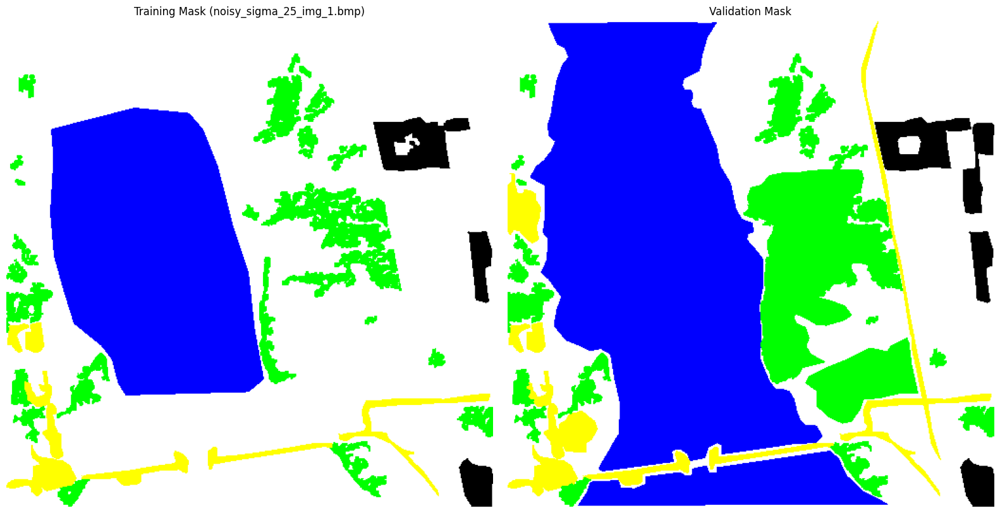

Accuracy: 97.00%
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15704
           1       0.96      0.97      0.97      5889
           2       0.85      0.86      0.85      1897
           3       0.90      0.86      0.88      2305

    accuracy                           0.97     25795
   macro avg       0.93      0.92      0.93     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: noisy_sigma_25_img_1.bmp
Image to classify is noisy_sigma_25_img_1.bmp


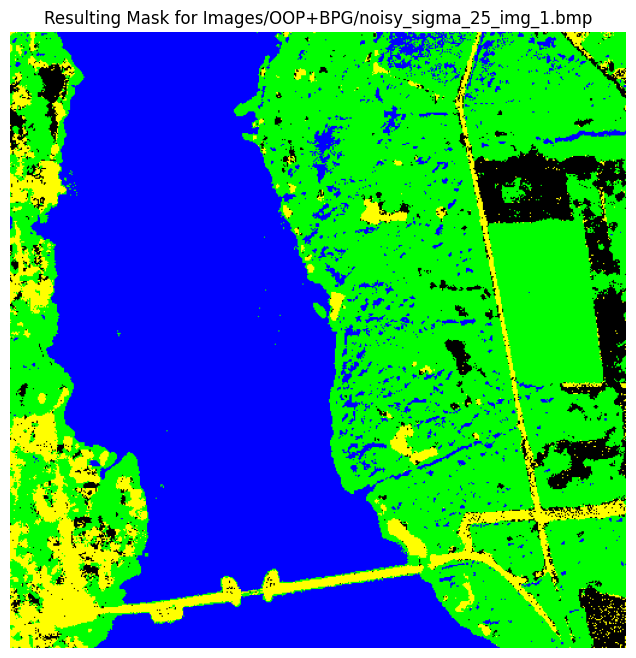

Result saved to: Images/temp/result_colored_mask_noisy_sigma_25_img_1.bmp
Evaluation Accuracy on Eval Image: 96.41%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.98      1.00      0.99      96852     
1         0.96      0.93      0.94      38258     
2         0.85      0.90      0.88      7898      
3         0.96      0.84      0.90      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.93      0.92      0.93      155162    
Weighted Avg0.96      0.96      0.96      155162    
Image to classify is reconstructed_q31_sigma_25_img_1.png


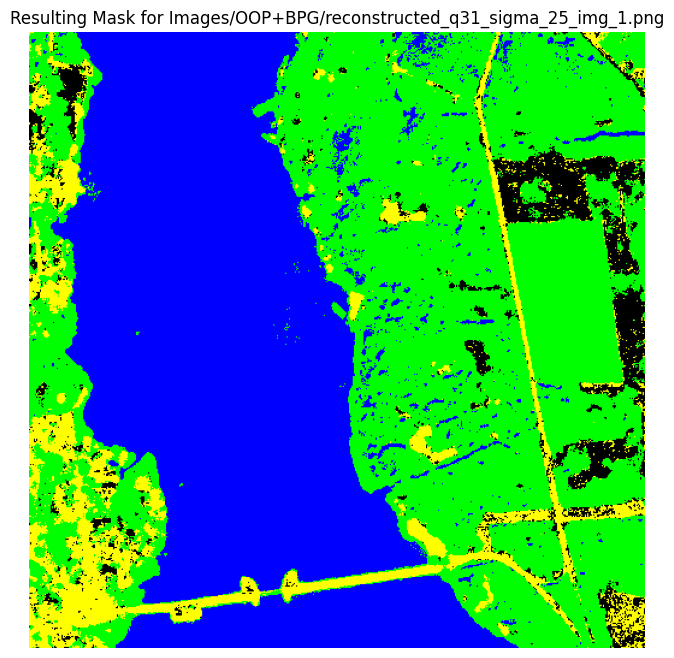

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_25_img_1.png
Evaluation Accuracy on Eval Image: 95.95%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.98      1.00      0.99      96852     
1         0.95      0.94      0.95      38258     
2         0.81      0.77      0.79      7898      
3         0.87      0.83      0.85      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.90      0.88      0.89      155162    
Weighted Avg0.96      0.96      0.96      155162    
Image to classify is reconstructed_q35_sigma_25_img_1.png


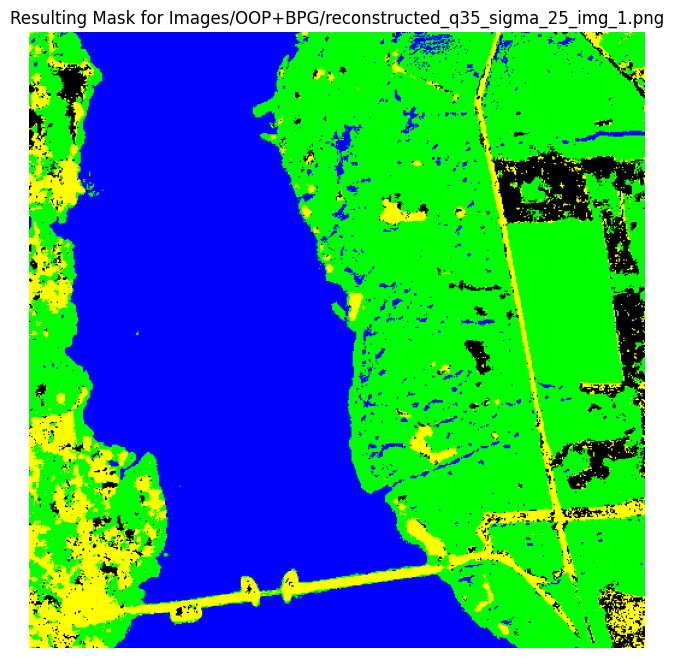

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_25_img_1.png
Evaluation Accuracy on Eval Image: 96.22%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      1.00      0.99      96852     
1         0.95      0.95      0.95      38258     
2         0.82      0.76      0.79      7898      
3         0.86      0.83      0.85      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.91      0.89      0.90      155162    
Weighted Avg0.96      0.96      0.96      155162    
Time taken for SS1, sigma^2=25, training on noisy_sigma_25_img_1.bmp: 354.71 seconds

Training model using Images/OOP+BPG/reconstructed_q31_sigma_25_img_1.png


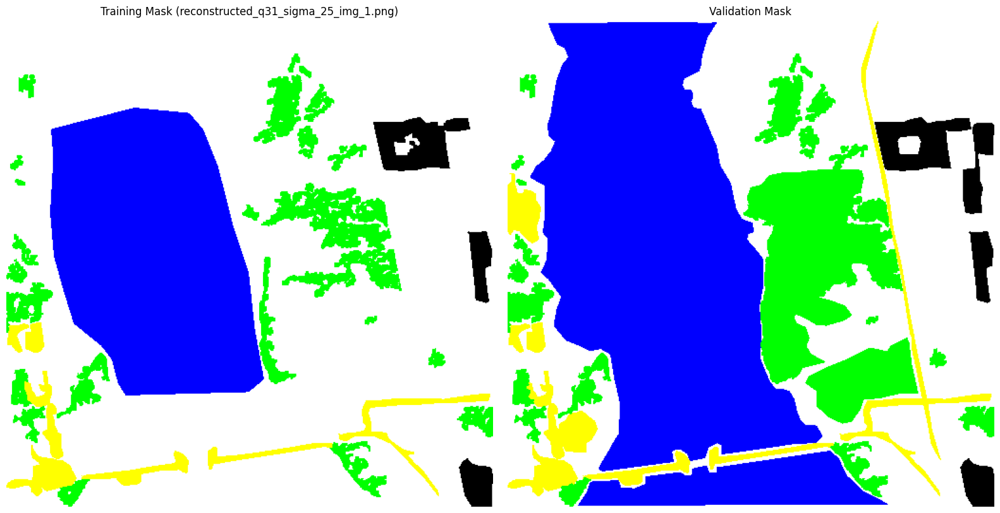

Accuracy: 97.48%
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15607
           1       0.97      0.98      0.98      6042
           2       0.86      0.88      0.87      1893
           3       0.91      0.87      0.89      2253

    accuracy                           0.97     25795
   macro avg       0.93      0.93      0.93     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: reconstructed_q31_sigma_25_img_1.png
Image to classify is noisy_sigma_25_img_1.bmp


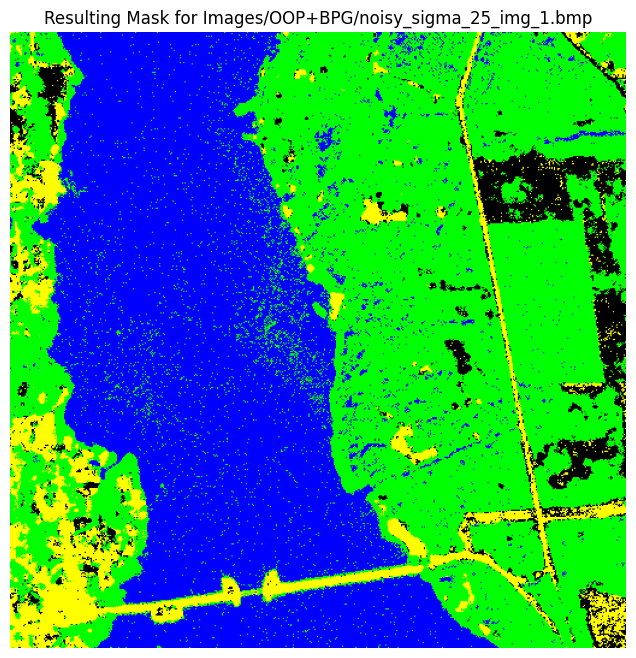

Result saved to: Images/temp/result_colored_mask_noisy_sigma_25_img_1.bmp
Evaluation Accuracy on Eval Image: 93.23%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.98      0.96      0.97      96852     
1         0.86      0.95      0.90      38258     
2         0.78      0.77      0.77      7898      
3         0.88      0.81      0.84      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.87      0.87      0.87      155162    
Weighted Avg0.93      0.93      0.93      155162    
Image to classify is reconstructed_q31_sigma_25_img_1.png


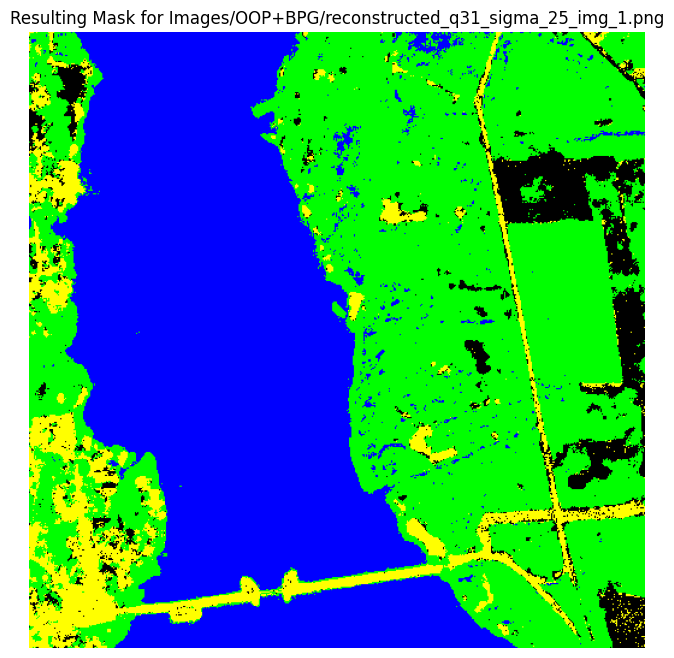

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_25_img_1.png
Evaluation Accuracy on Eval Image: 97.35%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      1.00      0.99      96852     
1         0.96      0.97      0.96      38258     
2         0.84      0.91      0.88      7898      
3         0.96      0.84      0.90      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.94      0.93      0.93      155162    
Weighted Avg0.97      0.97      0.97      155162    
Image to classify is reconstructed_q35_sigma_25_img_1.png


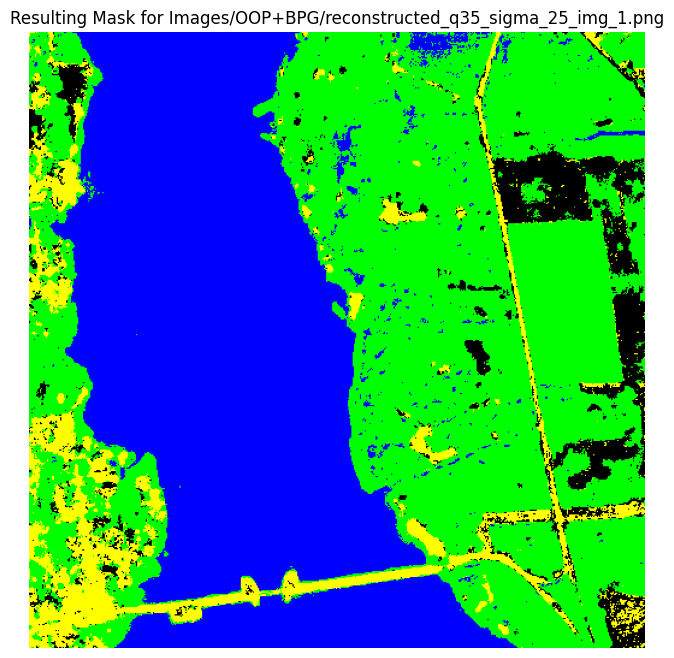

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_25_img_1.png
Evaluation Accuracy on Eval Image: 96.70%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      1.00      1.00      96852     
1         0.95      0.97      0.96      38258     
2         0.79      0.86      0.82      7898      
3         0.92      0.80      0.86      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.91      0.91      0.91      155162    
Weighted Avg0.97      0.97      0.97      155162    
Time taken for SS1, sigma^2=25, training on reconstructed_q31_sigma_25_img_1.png: 351.72 seconds

Training model using Images/OOP+BPG/reconstructed_q35_sigma_25_img_1.png


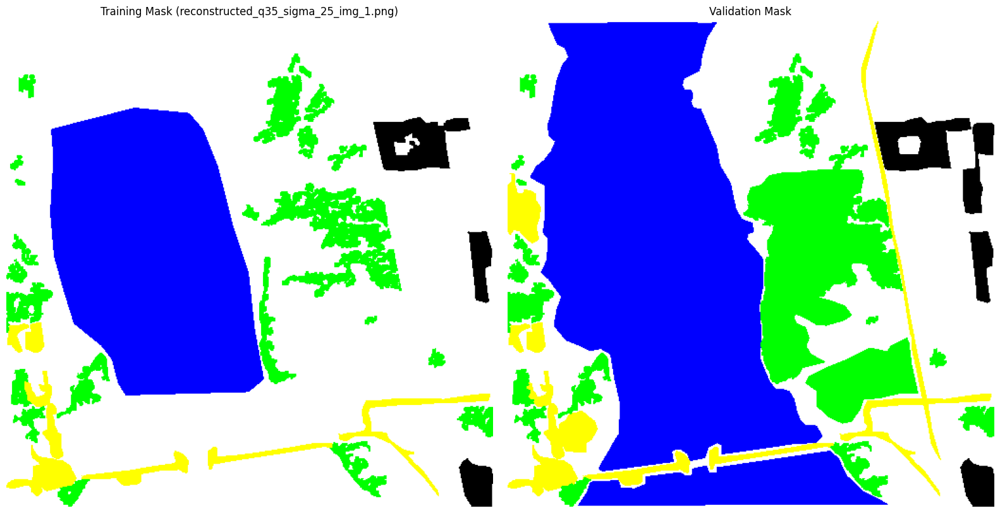

Accuracy: 97.46%
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15622
           1       0.97      0.98      0.98      6016
           2       0.87      0.87      0.87      1885
           3       0.90      0.88      0.89      2272

    accuracy                           0.97     25795
   macro avg       0.93      0.93      0.93     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: reconstructed_q35_sigma_25_img_1.png
Image to classify is noisy_sigma_25_img_1.bmp


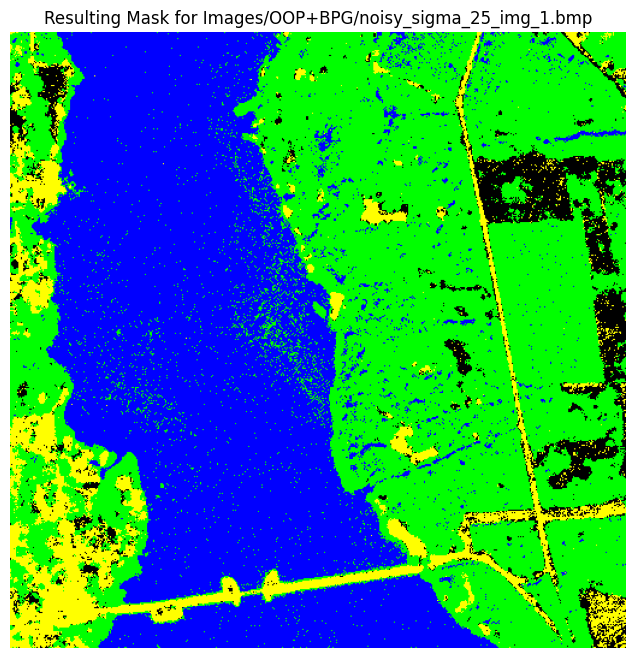

Result saved to: Images/temp/result_colored_mask_noisy_sigma_25_img_1.bmp
Evaluation Accuracy on Eval Image: 93.45%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.98      0.96      0.97      96852     
1         0.87      0.94      0.90      38258     
2         0.78      0.76      0.77      7898      
3         0.87      0.81      0.83      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.87      0.87      0.87      155162    
Weighted Avg0.94      0.93      0.93      155162    
Image to classify is reconstructed_q31_sigma_25_img_1.png


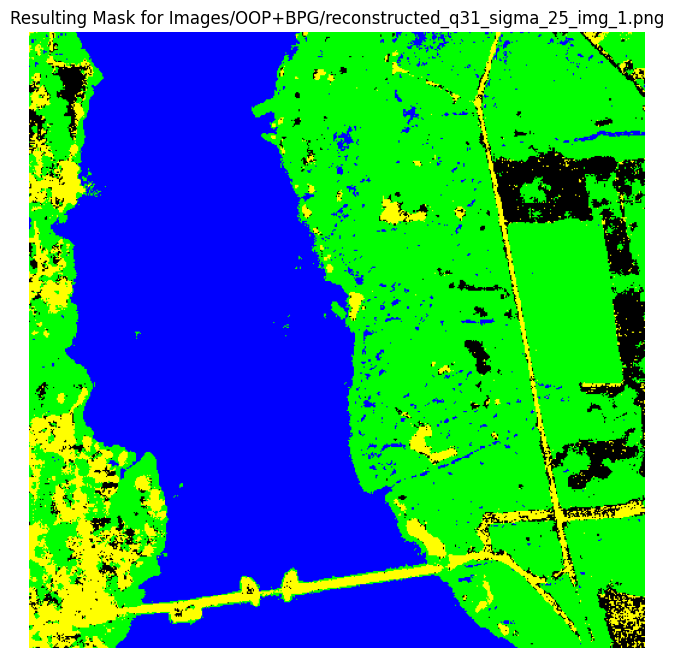

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_25_img_1.png
Evaluation Accuracy on Eval Image: 96.39%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      1.00      0.99      96852     
1         0.95      0.96      0.95      38258     
2         0.79      0.84      0.81      7898      
3         0.91      0.80      0.85      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.91      0.90      0.90      155162    
Weighted Avg0.96      0.96      0.96      155162    
Image to classify is reconstructed_q35_sigma_25_img_1.png


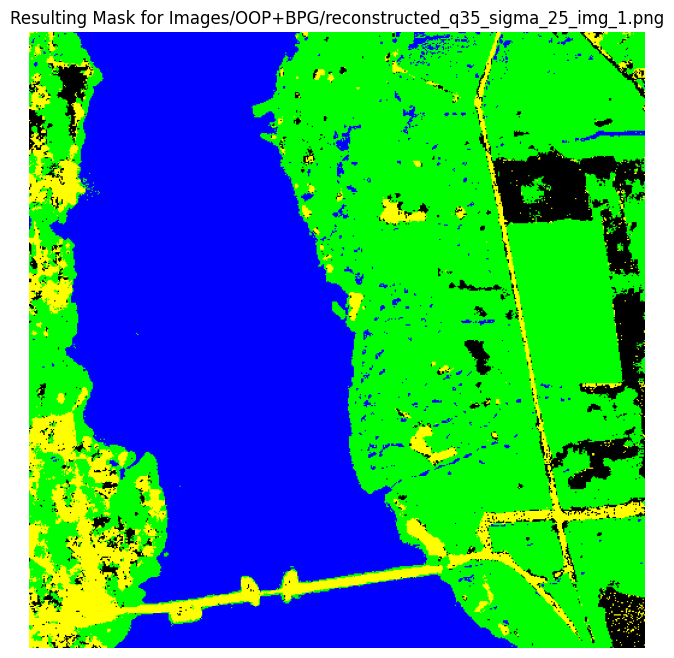

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_25_img_1.png
Evaluation Accuracy on Eval Image: 97.45%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      1.00      1.00      96852     
1         0.96      0.97      0.97      38258     
2         0.85      0.91      0.88      7898      
3         0.96      0.84      0.90      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.94      0.93      0.93      155162    
Weighted Avg0.97      0.97      0.97      155162    
Time taken for SS1, sigma^2=25, training on reconstructed_q35_sigma_25_img_1.png: 374.18 seconds

=== Processing for sigma^2 = 25, Case: SS2 ===

Training model using Images/OOP+BPG/noisy_sigma_25_img_2.bmp


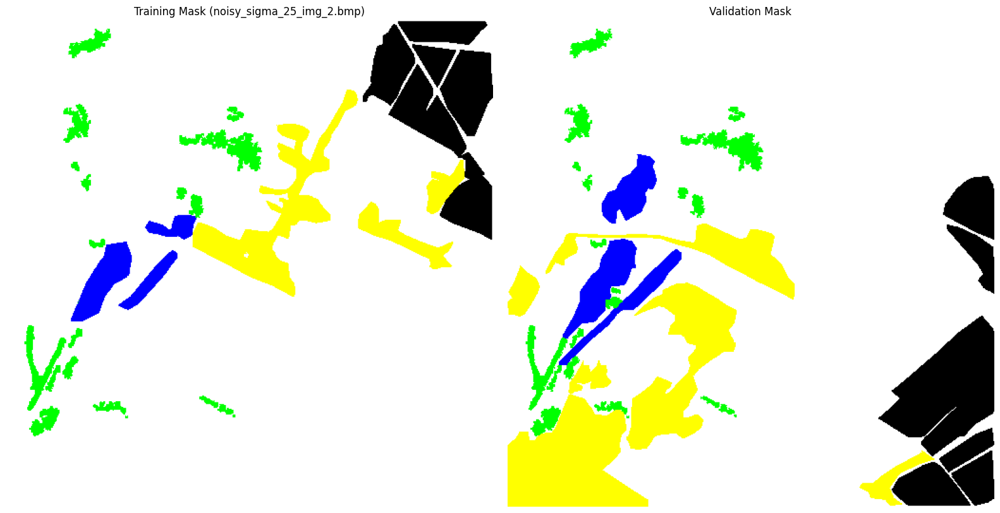

Accuracy: 92.66%
Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.93      0.93      1247
           1       0.86      0.87      0.86      1809
           2       0.95      0.95      0.95      4508
           3       0.94      0.92      0.93      3460

    accuracy                           0.93     11024
   macro avg       0.92      0.92      0.92     11024
weighted avg       0.93      0.93      0.93     11024

Model trained with: noisy_sigma_25_img_2.bmp
Image to classify is noisy_sigma_25_img_2.bmp


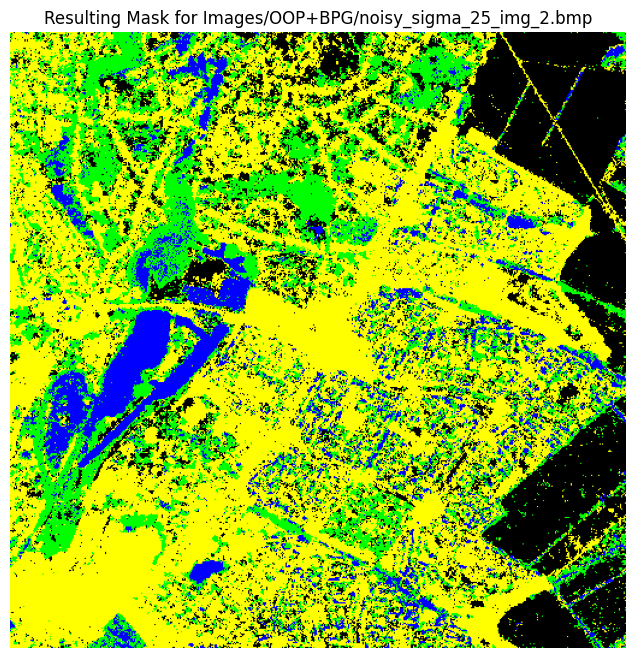

Result saved to: Images/temp/result_colored_mask_noisy_sigma_25_img_2.bmp
Evaluation Accuracy on Eval Image: 88.64%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.88      0.72      0.79      7117      
1         0.58      0.96      0.72      6032      
2         0.95      0.88      0.91      19125     
3         0.96      0.92      0.94      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.84      0.87      0.84      60314     
Weighted Avg0.91      0.89      0.89      60314     
Image to classify is reconstructed_q31_sigma_25_img_2.png


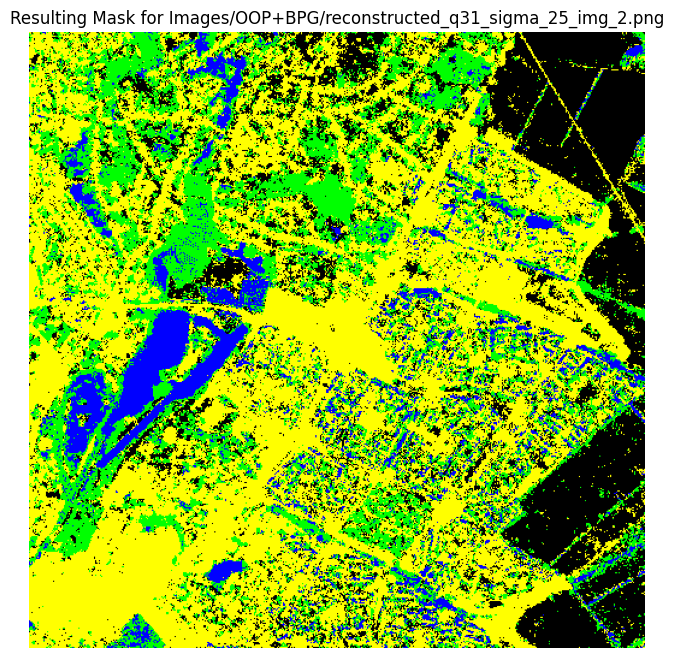

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_25_img_2.png
Evaluation Accuracy on Eval Image: 86.67%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.87      0.67      0.76      7117      
1         0.53      0.89      0.66      6032      
2         0.94      0.87      0.90      19125     
3         0.95      0.91      0.93      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.82      0.84      0.81      60314     
Weighted Avg0.89      0.87      0.87      60314     
Image to classify is reconstructed_q35_sigma_25_img_2.png


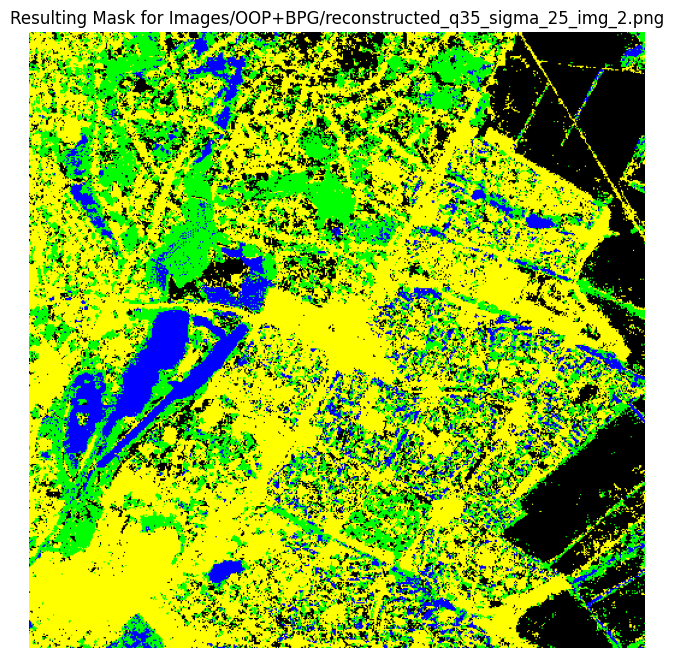

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_25_img_2.png
Evaluation Accuracy on Eval Image: 86.14%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.87      0.66      0.75      7117      
1         0.52      0.89      0.66      6032      
2         0.94      0.86      0.90      19125     
3         0.94      0.91      0.92      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.82      0.83      0.81      60314     
Weighted Avg0.89      0.86      0.87      60314     
Time taken for SS2, sigma^2=25, training on noisy_sigma_25_img_2.bmp: 354.70 seconds

Training model using Images/OOP+BPG/reconstructed_q31_sigma_25_img_2.png


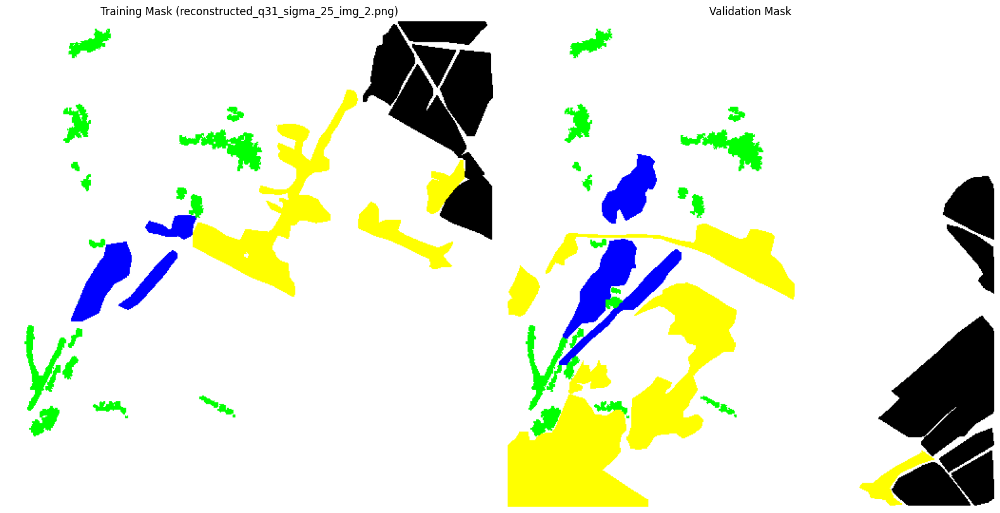

Accuracy: 93.26%
Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.95      0.95      1268
           1       0.88      0.88      0.88      1843
           2       0.95      0.95      0.95      4469
           3       0.93      0.93      0.93      3444

    accuracy                           0.93     11024
   macro avg       0.93      0.93      0.93     11024
weighted avg       0.93      0.93      0.93     11024

Model trained with: reconstructed_q31_sigma_25_img_2.png
Image to classify is noisy_sigma_25_img_2.bmp


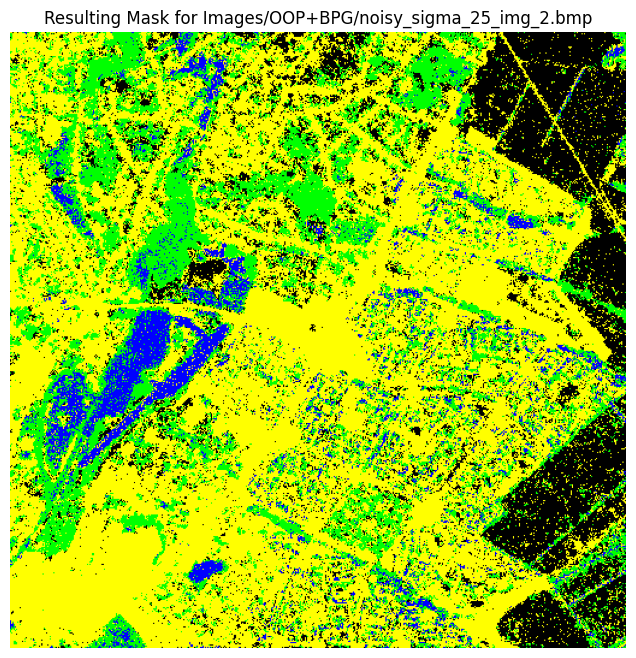

Result saved to: Images/temp/result_colored_mask_noisy_sigma_25_img_2.bmp
Evaluation Accuracy on Eval Image: 83.20%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.89      0.56      0.69      7117      
1         0.48      0.89      0.62      6032      
2         0.95      0.77      0.85      19125     
3         0.89      0.93      0.91      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.80      0.79      0.77      60314     
Weighted Avg0.87      0.83      0.84      60314     
Image to classify is reconstructed_q31_sigma_25_img_2.png


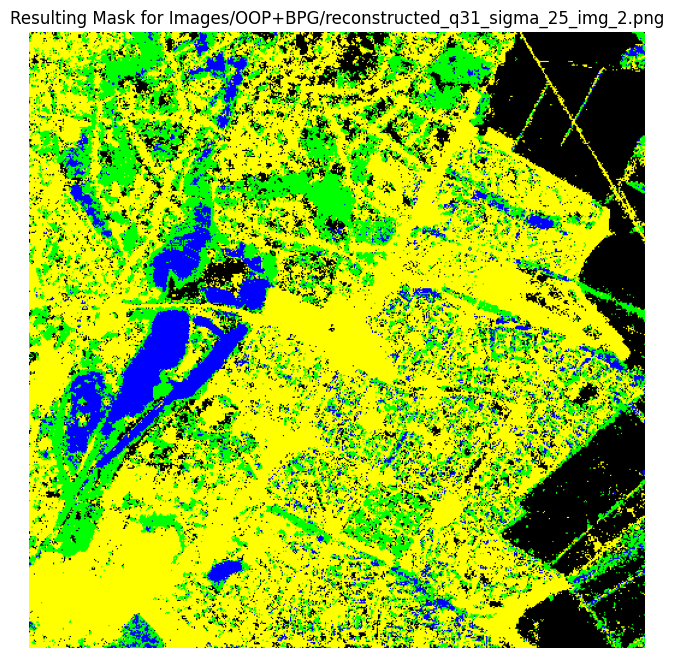

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_25_img_2.png
Evaluation Accuracy on Eval Image: 90.08%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.92      0.83      0.87      7117      
1         0.62      0.97      0.75      6032      
2         0.96      0.87      0.91      19125     
3         0.96      0.92      0.94      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.86      0.90      0.87      60314     
Weighted Avg0.92      0.90      0.91      60314     
Image to classify is reconstructed_q35_sigma_25_img_2.png


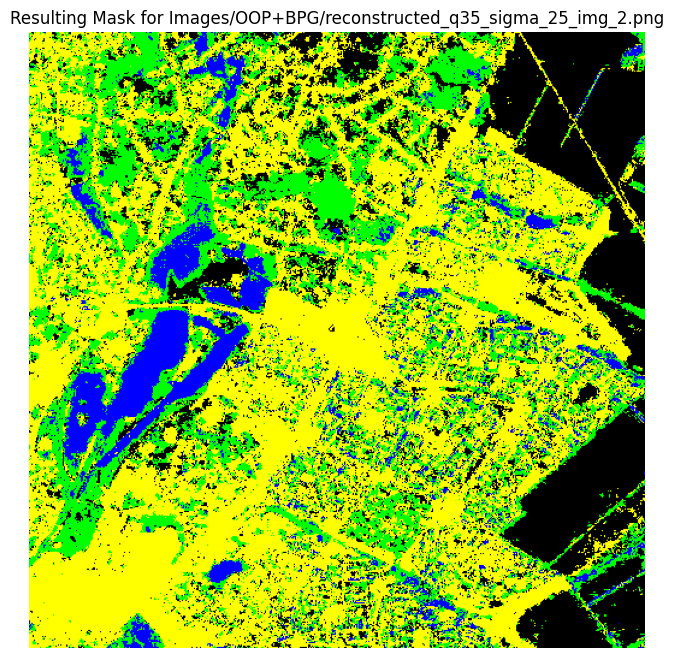

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_25_img_2.png
Evaluation Accuracy on Eval Image: 89.75%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.89      0.83      0.86      7117      
1         0.61      0.91      0.73      6032      
2         0.94      0.89      0.92      19125     
3         0.96      0.92      0.94      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.85      0.89      0.86      60314     
Weighted Avg0.91      0.90      0.90      60314     
Time taken for SS2, sigma^2=25, training on reconstructed_q31_sigma_25_img_2.png: 344.51 seconds

Training model using Images/OOP+BPG/reconstructed_q35_sigma_25_img_2.png


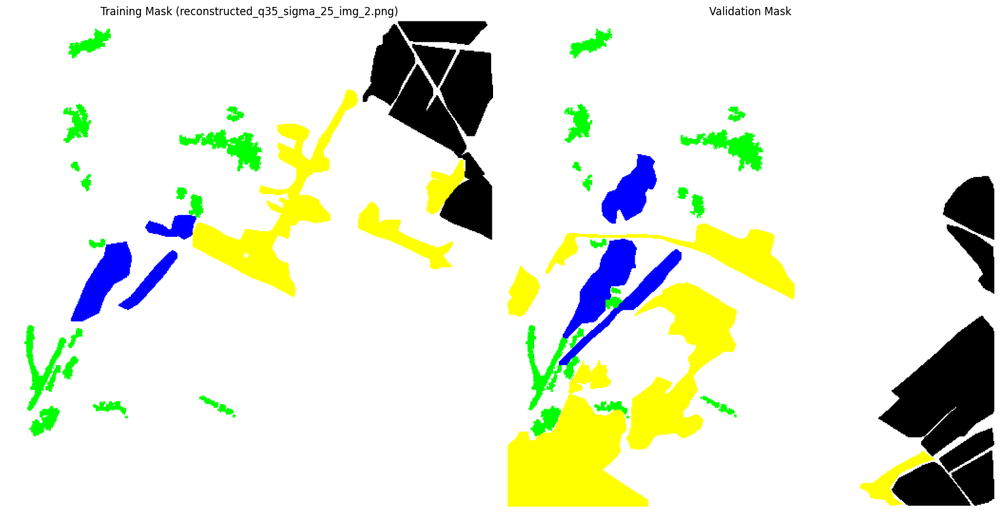

Accuracy: 94.67%
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      1233
           1       0.91      0.91      0.91      1807
           2       0.97      0.96      0.96      4578
           3       0.93      0.94      0.94      3406

    accuracy                           0.95     11024
   macro avg       0.94      0.94      0.94     11024
weighted avg       0.95      0.95      0.95     11024

Model trained with: reconstructed_q35_sigma_25_img_2.png
Image to classify is noisy_sigma_25_img_2.bmp


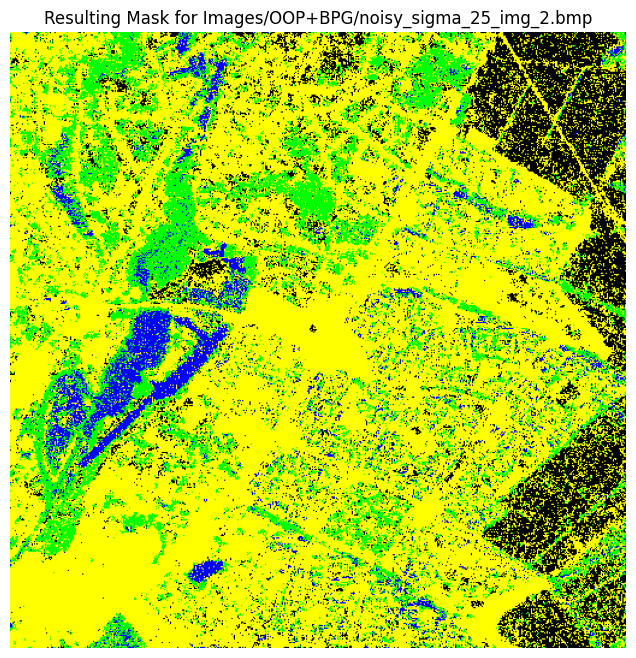

Result saved to: Images/temp/result_colored_mask_noisy_sigma_25_img_2.bmp
Evaluation Accuracy on Eval Image: 76.85%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.90      0.54      0.68      7117      
1         0.47      0.78      0.59      6032      
2         0.96      0.59      0.73      19125     
3         0.77      0.95      0.85      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.78      0.71      0.71      60314     
Weighted Avg0.82      0.77      0.77      60314     
Image to classify is reconstructed_q31_sigma_25_img_2.png


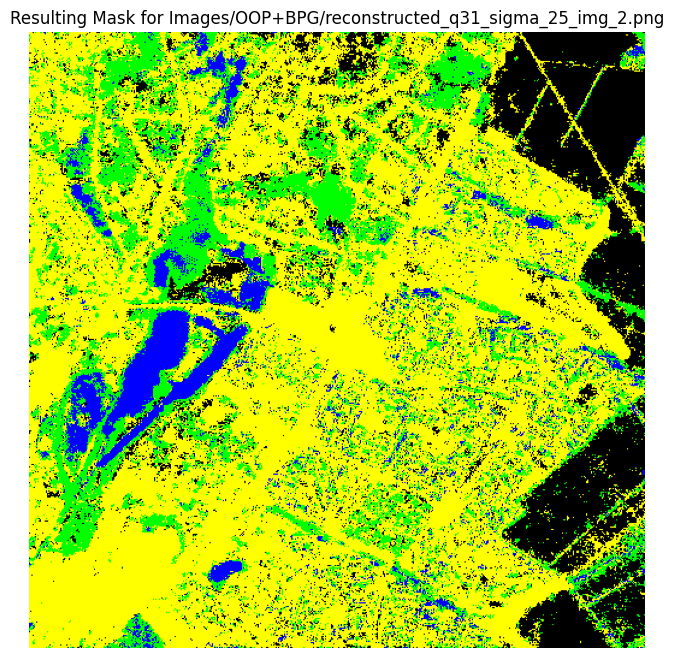

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_25_img_2.png
Evaluation Accuracy on Eval Image: 86.34%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.92      0.69      0.79      7117      
1         0.53      0.88      0.66      6032      
2         0.96      0.81      0.88      19125     
3         0.91      0.94      0.93      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.83      0.83      0.81      60314     
Weighted Avg0.89      0.86      0.87      60314     
Image to classify is reconstructed_q35_sigma_25_img_2.png


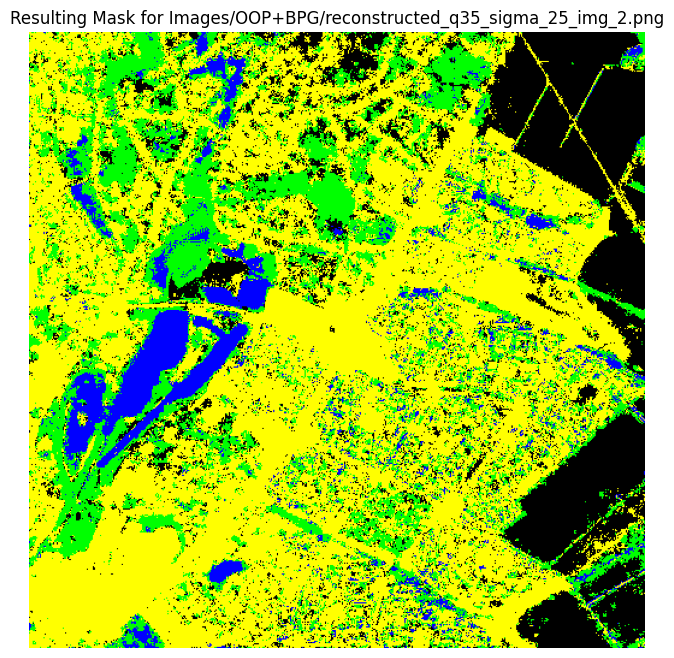

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_25_img_2.png
Evaluation Accuracy on Eval Image: 88.68%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.91      0.69      0.79      7117      
1         0.56      0.97      0.71      6032      
2         0.97      0.86      0.91      19125     
3         0.96      0.93      0.94      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.85      0.87      0.84      60314     
Weighted Avg0.91      0.89      0.89      60314     
Time taken for SS2, sigma^2=25, training on reconstructed_q35_sigma_25_img_2.png: 350.43 seconds

=== Processing for sigma^2 = 50, Case: SS1 ===

Training model using Images/OOP+BPG/noisy_sigma_50_img_1.bmp


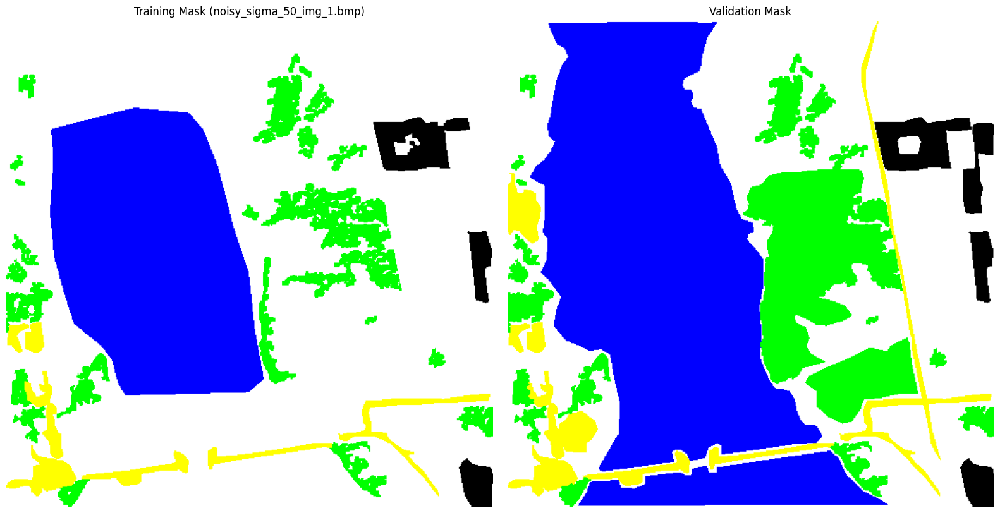

Accuracy: 96.98%
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15762
           1       0.96      0.97      0.96      5953
           2       0.86      0.85      0.86      1871
           3       0.90      0.88      0.89      2209

    accuracy                           0.97     25795
   macro avg       0.93      0.92      0.93     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: noisy_sigma_50_img_1.bmp
Image to classify is noisy_sigma_50_img_1.bmp


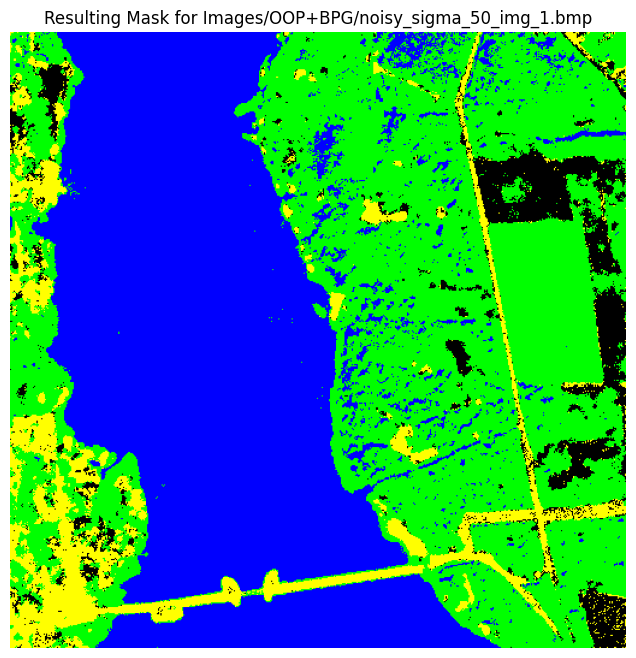

Result saved to: Images/temp/result_colored_mask_noisy_sigma_50_img_1.bmp
Evaluation Accuracy on Eval Image: 96.19%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.97      1.00      0.99      96852     
1         0.96      0.92      0.94      38258     
2         0.84      0.90      0.87      7898      
3         0.96      0.84      0.90      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.93      0.92      0.92      155162    
Weighted Avg0.96      0.96      0.96      155162    
Image to classify is reconstructed_q31_sigma_50_img_1.png


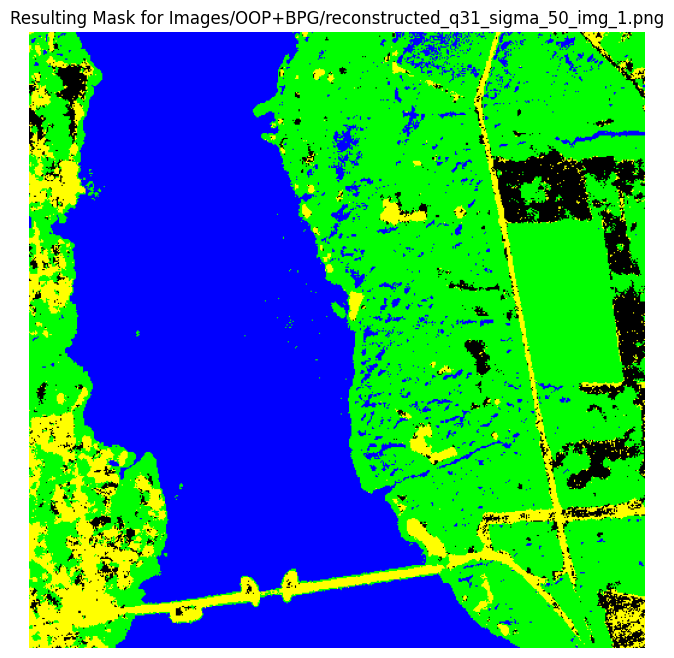

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_50_img_1.png
Evaluation Accuracy on Eval Image: 95.69%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.98      1.00      0.99      96852     
1         0.95      0.93      0.94      38258     
2         0.80      0.80      0.80      7898      
3         0.89      0.82      0.85      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.90      0.89      0.90      155162    
Weighted Avg0.96      0.96      0.96      155162    
Image to classify is reconstructed_q35_sigma_50_img_1.png


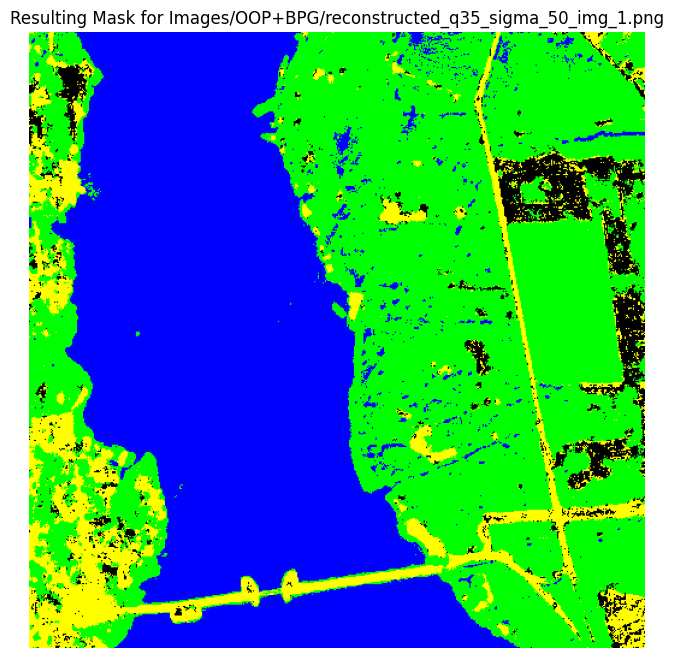

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_50_img_1.png
Evaluation Accuracy on Eval Image: 95.91%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      1.00      0.99      96852     
1         0.95      0.95      0.95      38258     
2         0.82      0.69      0.75      7898      
3         0.82      0.85      0.84      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.90      0.87      0.88      155162    
Weighted Avg0.96      0.96      0.96      155162    
Time taken for SS1, sigma^2=50, training on noisy_sigma_50_img_1.bmp: 349.99 seconds

Training model using Images/OOP+BPG/reconstructed_q31_sigma_50_img_1.png


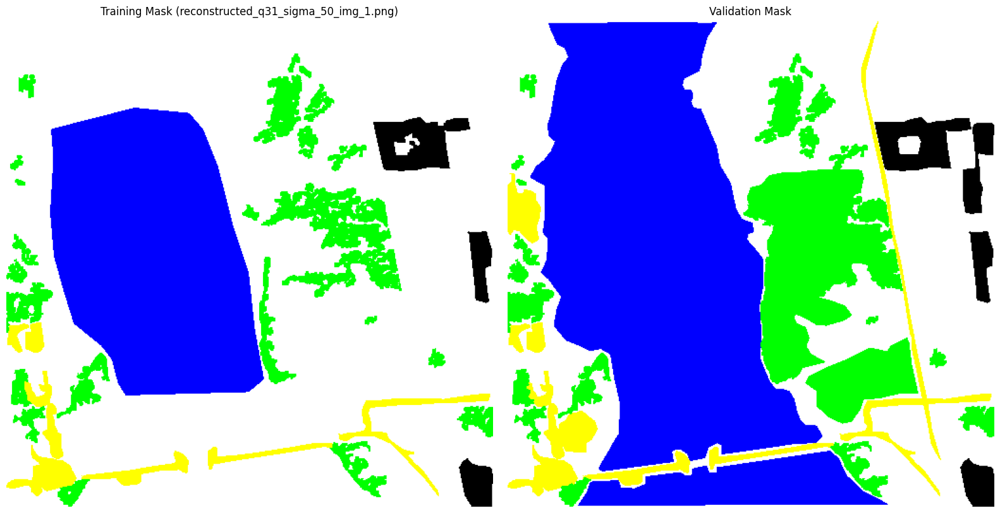

Accuracy: 97.15%
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15565
           1       0.97      0.98      0.97      5992
           2       0.85      0.85      0.85      1927
           3       0.89      0.87      0.88      2311

    accuracy                           0.97     25795
   macro avg       0.93      0.93      0.93     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: reconstructed_q31_sigma_50_img_1.png
Image to classify is noisy_sigma_50_img_1.bmp


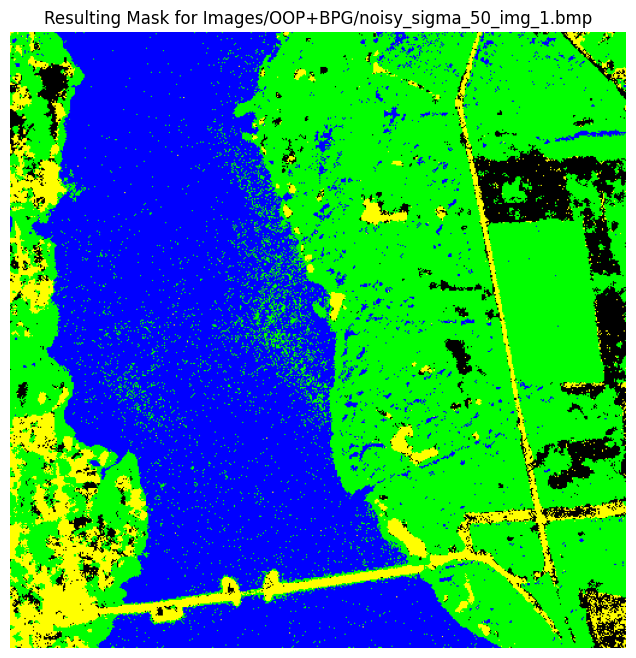

Result saved to: Images/temp/result_colored_mask_noisy_sigma_50_img_1.bmp
Evaluation Accuracy on Eval Image: 92.75%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      0.95      0.97      96852     
1         0.84      0.95      0.89      38258     
2         0.77      0.83      0.79      7898      
3         0.90      0.79      0.84      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.87      0.88      0.87      155162    
Weighted Avg0.93      0.93      0.93      155162    
Image to classify is reconstructed_q31_sigma_50_img_1.png


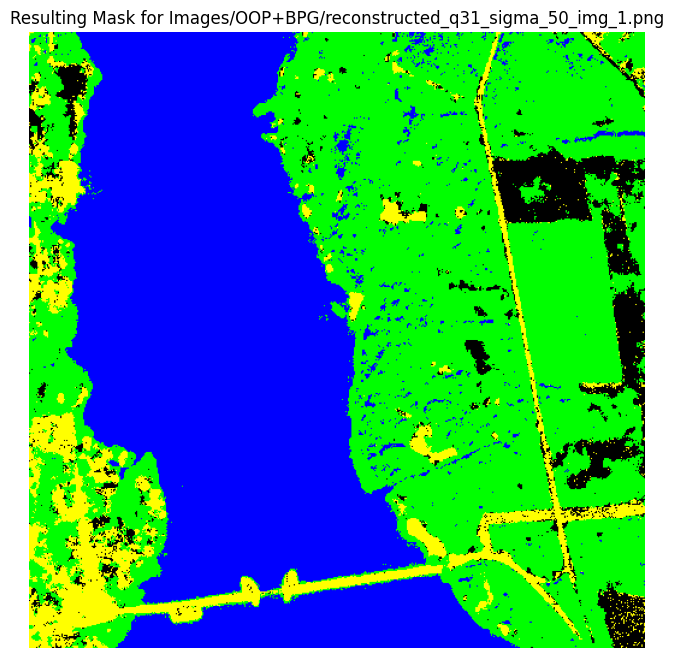

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_50_img_1.png
Evaluation Accuracy on Eval Image: 97.14%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      1.00      0.99      96852     
1         0.96      0.96      0.96      38258     
2         0.85      0.91      0.88      7898      
3         0.95      0.85      0.90      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.94      0.93      0.93      155162    
Weighted Avg0.97      0.97      0.97      155162    
Image to classify is reconstructed_q35_sigma_50_img_1.png


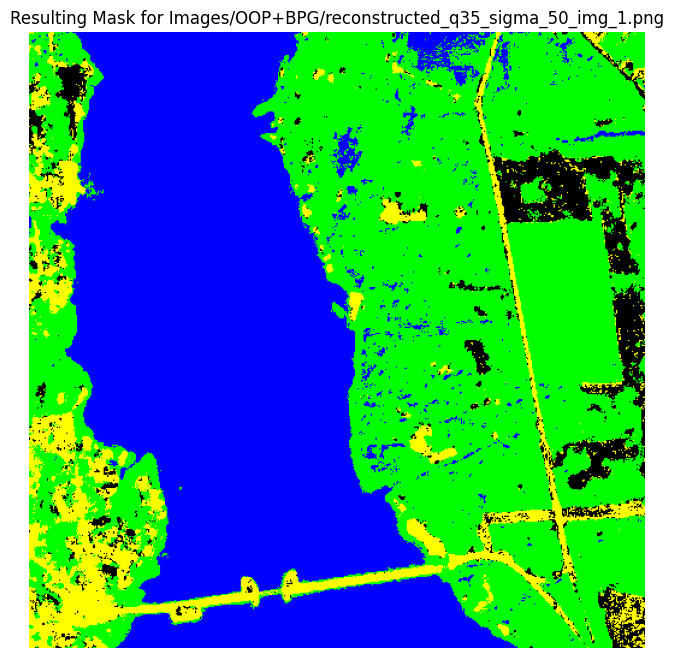

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_50_img_1.png
Evaluation Accuracy on Eval Image: 96.23%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      1.00      0.99      96852     
1         0.95      0.95      0.95      38258     
2         0.80      0.80      0.80      7898      
3         0.89      0.81      0.85      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.91      0.89      0.90      155162    
Weighted Avg0.96      0.96      0.96      155162    
Time taken for SS1, sigma^2=50, training on reconstructed_q31_sigma_50_img_1.png: 338.08 seconds

Training model using Images/OOP+BPG/reconstructed_q35_sigma_50_img_1.png


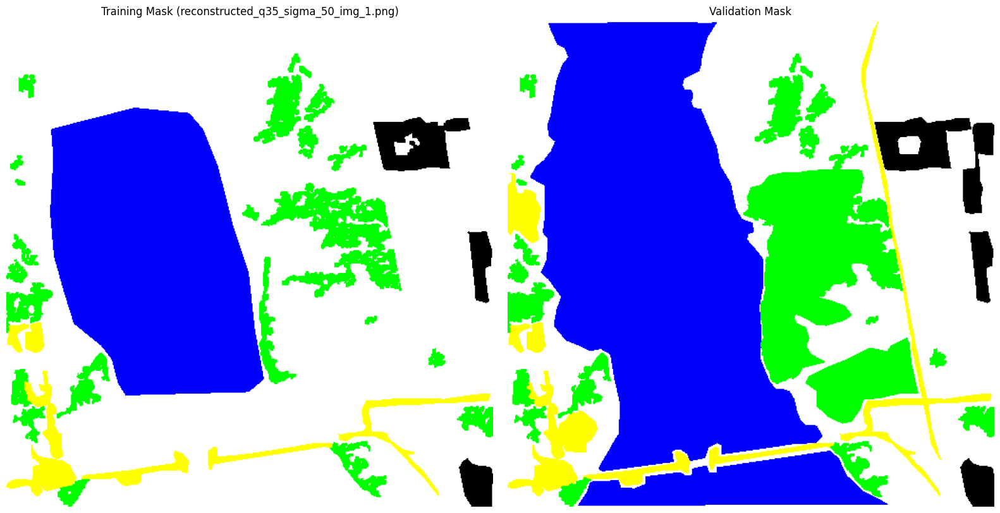

Accuracy: 97.62%
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15566
           1       0.97      0.98      0.98      6069
           2       0.88      0.89      0.88      1945
           3       0.91      0.88      0.90      2215

    accuracy                           0.98     25795
   macro avg       0.94      0.94      0.94     25795
weighted avg       0.98      0.98      0.98     25795

Model trained with: reconstructed_q35_sigma_50_img_1.png
Image to classify is noisy_sigma_50_img_1.bmp


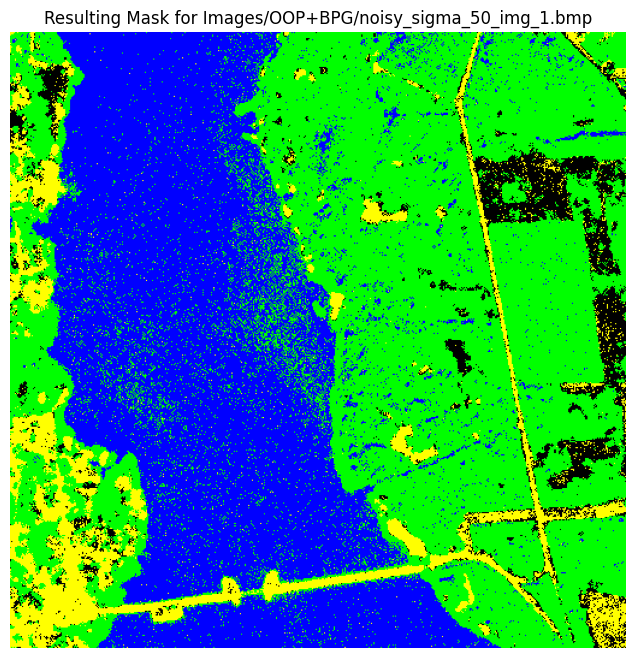

Result saved to: Images/temp/result_colored_mask_noisy_sigma_50_img_1.bmp
Evaluation Accuracy on Eval Image: 89.78%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.98      0.91      0.94      96852     
1         0.77      0.94      0.85      38258     
2         0.77      0.71      0.74      7898      
3         0.83      0.80      0.82      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.84      0.84      0.84      155162    
Weighted Avg0.91      0.90      0.90      155162    
Image to classify is reconstructed_q31_sigma_50_img_1.png


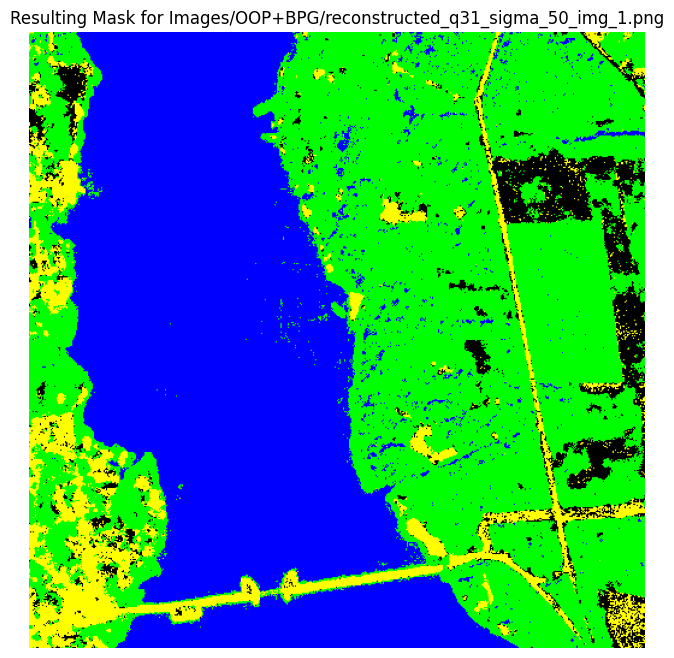

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_50_img_1.png
Evaluation Accuracy on Eval Image: 95.84%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      0.99      0.99      96852     
1         0.94      0.95      0.95      38258     
2         0.78      0.78      0.78      7898      
3         0.89      0.81      0.84      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.90      0.88      0.89      155162    
Weighted Avg0.96      0.96      0.96      155162    
Image to classify is reconstructed_q35_sigma_50_img_1.png


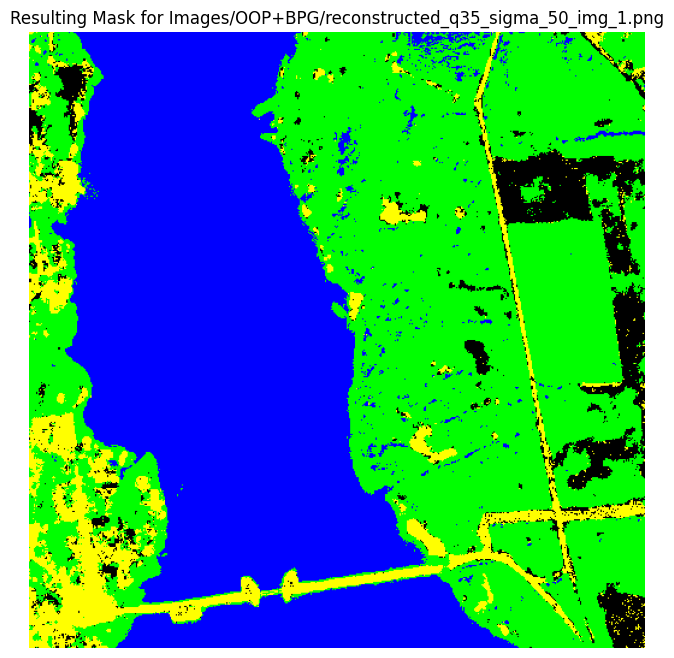

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_50_img_1.png
Evaluation Accuracy on Eval Image: 97.47%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      1.00      1.00      96852     
1         0.96      0.97      0.97      38258     
2         0.85      0.91      0.88      7898      
3         0.96      0.85      0.90      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.94      0.93      0.94      155162    
Weighted Avg0.98      0.97      0.97      155162    
Time taken for SS1, sigma^2=50, training on reconstructed_q35_sigma_50_img_1.png: 342.48 seconds

=== Processing for sigma^2 = 50, Case: SS2 ===

Training model using Images/OOP+BPG/noisy_sigma_50_img_2.bmp


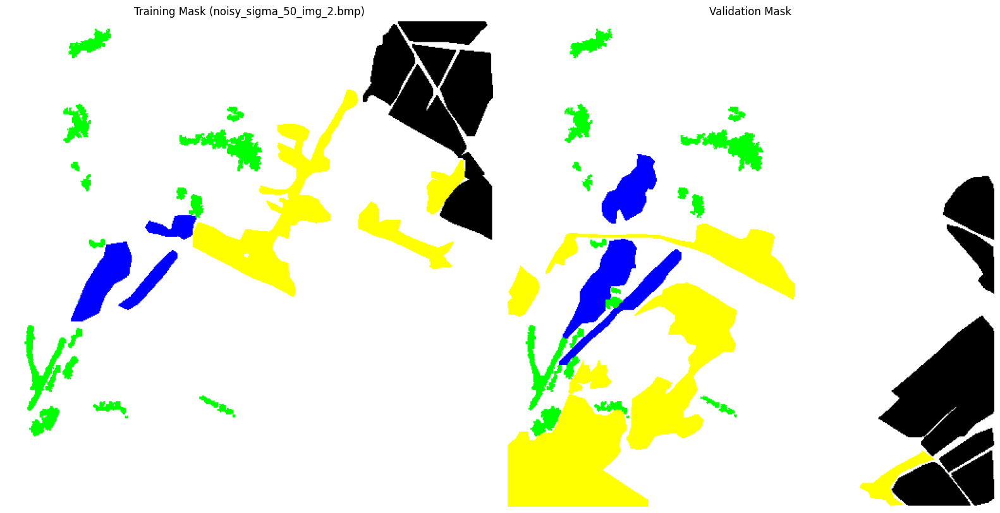

Accuracy: 91.22%
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.91      0.90      1257
           1       0.83      0.83      0.83      1812
           2       0.93      0.95      0.94      4487
           3       0.94      0.90      0.92      3468

    accuracy                           0.91     11024
   macro avg       0.90      0.90      0.90     11024
weighted avg       0.91      0.91      0.91     11024

Model trained with: noisy_sigma_50_img_2.bmp
Image to classify is noisy_sigma_50_img_2.bmp


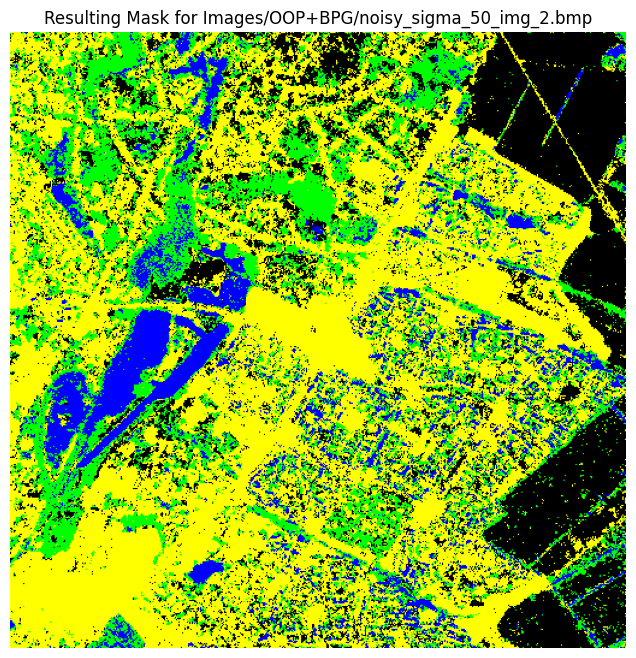

Result saved to: Images/temp/result_colored_mask_noisy_sigma_50_img_2.bmp
Evaluation Accuracy on Eval Image: 88.43%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.88      0.75      0.81      7117      
1         0.58      0.95      0.72      6032      
2         0.94      0.87      0.91      19125     
3         0.96      0.91      0.94      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.84      0.87      0.84      60314     
Weighted Avg0.91      0.88      0.89      60314     
Image to classify is reconstructed_q31_sigma_50_img_2.png


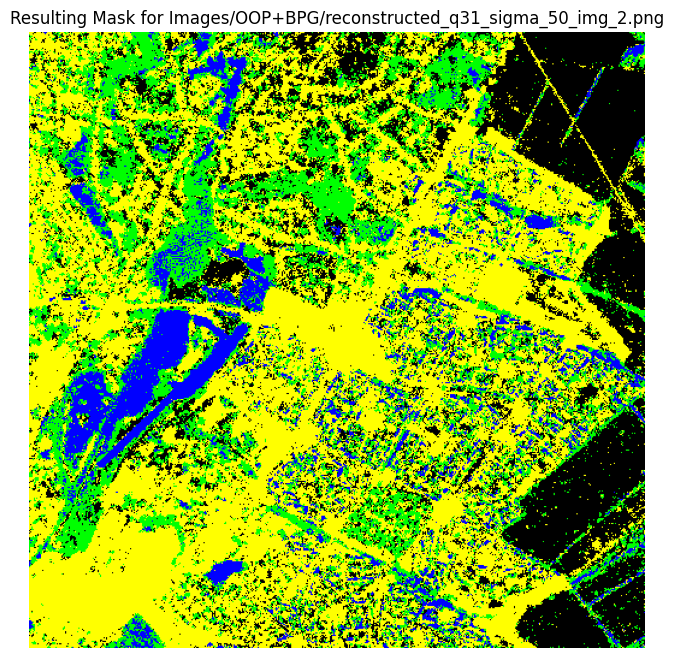

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_50_img_2.png
Evaluation Accuracy on Eval Image: 86.76%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.85      0.71      0.77      7117      
1         0.53      0.84      0.65      6032      
2         0.92      0.87      0.90      19125     
3         0.95      0.91      0.93      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.81      0.83      0.81      60314     
Weighted Avg0.89      0.87      0.87      60314     
Image to classify is reconstructed_q35_sigma_50_img_2.png


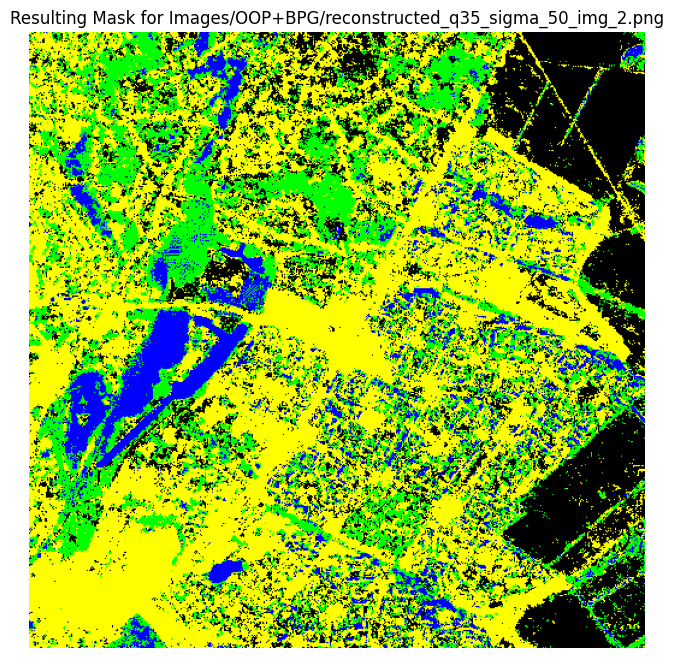

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_50_img_2.png
Evaluation Accuracy on Eval Image: 85.64%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.86      0.68      0.76      7117      
1         0.52      0.86      0.65      6032      
2         0.93      0.85      0.88      19125     
3         0.93      0.91      0.92      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.81      0.82      0.80      60314     
Weighted Avg0.88      0.86      0.86      60314     
Time taken for SS2, sigma^2=50, training on noisy_sigma_50_img_2.bmp: 347.84 seconds

Training model using Images/OOP+BPG/reconstructed_q31_sigma_50_img_2.png


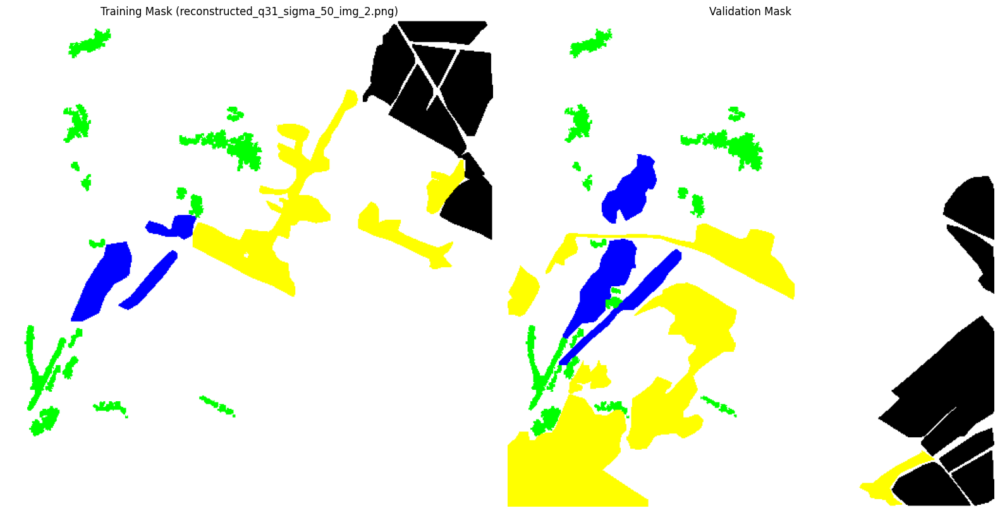

Accuracy: 91.67%
Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.93      0.92      1300
           1       0.84      0.83      0.84      1769
           2       0.93      0.95      0.94      4491
           3       0.94      0.91      0.92      3464

    accuracy                           0.92     11024
   macro avg       0.91      0.91      0.91     11024
weighted avg       0.92      0.92      0.92     11024

Model trained with: reconstructed_q31_sigma_50_img_2.png
Image to classify is noisy_sigma_50_img_2.bmp


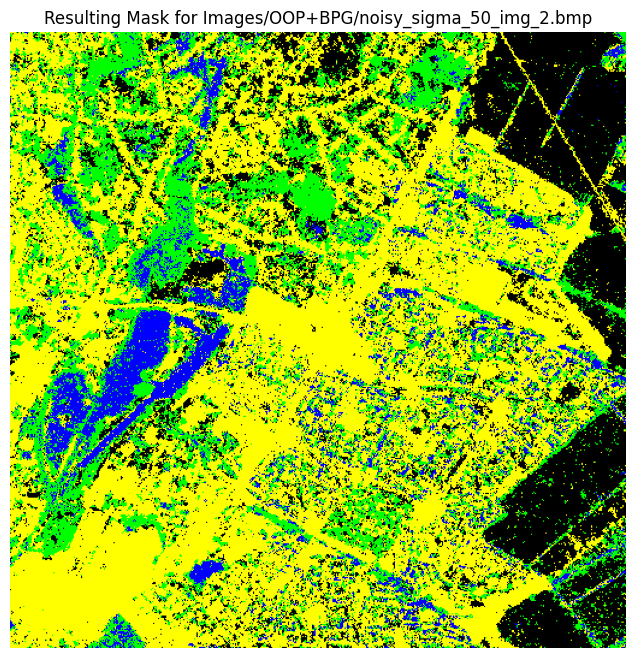

Result saved to: Images/temp/result_colored_mask_noisy_sigma_50_img_2.bmp
Evaluation Accuracy on Eval Image: 85.63%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.86      0.65      0.74      7117      
1         0.50      0.85      0.63      6032      
2         0.93      0.84      0.89      19125     
3         0.94      0.92      0.93      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.81      0.82      0.80      60314     
Weighted Avg0.88      0.86      0.86      60314     
Image to classify is reconstructed_q31_sigma_50_img_2.png


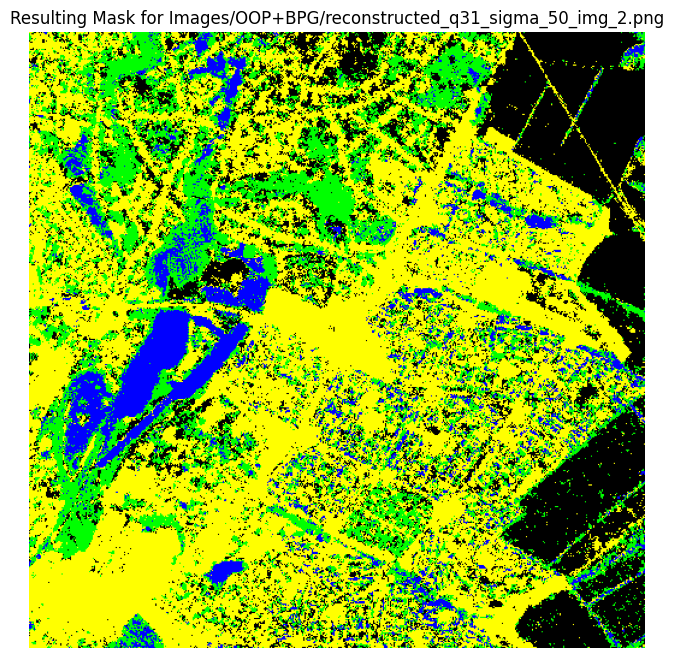

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_50_img_2.png
Evaluation Accuracy on Eval Image: 88.34%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.89      0.75      0.82      7117      
1         0.57      0.95      0.71      6032      
2         0.94      0.87      0.90      19125     
3         0.96      0.91      0.94      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.84      0.87      0.84      60314     
Weighted Avg0.91      0.88      0.89      60314     
Image to classify is reconstructed_q35_sigma_50_img_2.png


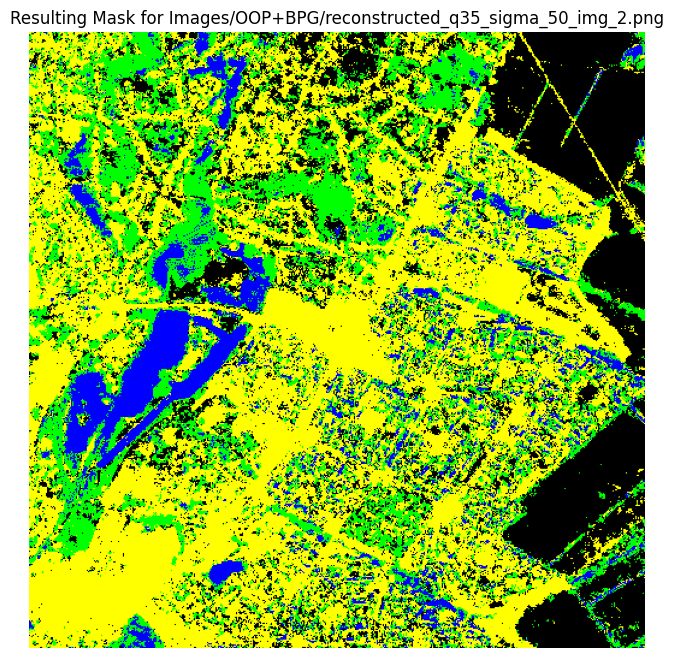

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_50_img_2.png
Evaluation Accuracy on Eval Image: 87.72%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.87      0.74      0.80      7117      
1         0.55      0.88      0.68      6032      
2         0.93      0.88      0.91      19125     
3         0.96      0.91      0.93      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.83      0.85      0.83      60314     
Weighted Avg0.90      0.88      0.88      60314     
Time taken for SS2, sigma^2=50, training on reconstructed_q31_sigma_50_img_2.png: 337.73 seconds

Training model using Images/OOP+BPG/reconstructed_q35_sigma_50_img_2.png


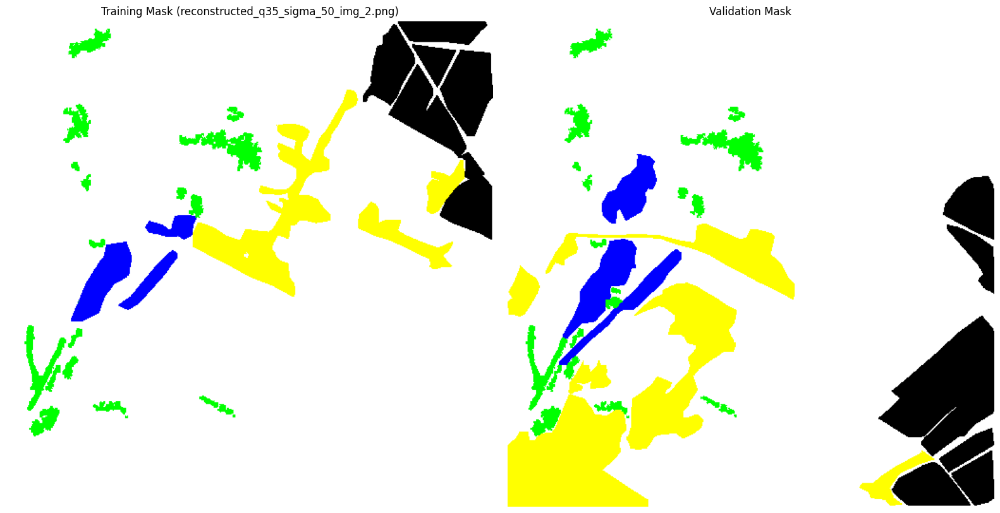

Accuracy: 93.82%
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.95      0.96      1245
           1       0.88      0.90      0.89      1748
           2       0.96      0.96      0.96      4575
           3       0.94      0.93      0.93      3456

    accuracy                           0.94     11024
   macro avg       0.93      0.93      0.93     11024
weighted avg       0.94      0.94      0.94     11024

Model trained with: reconstructed_q35_sigma_50_img_2.png
Image to classify is noisy_sigma_50_img_2.bmp


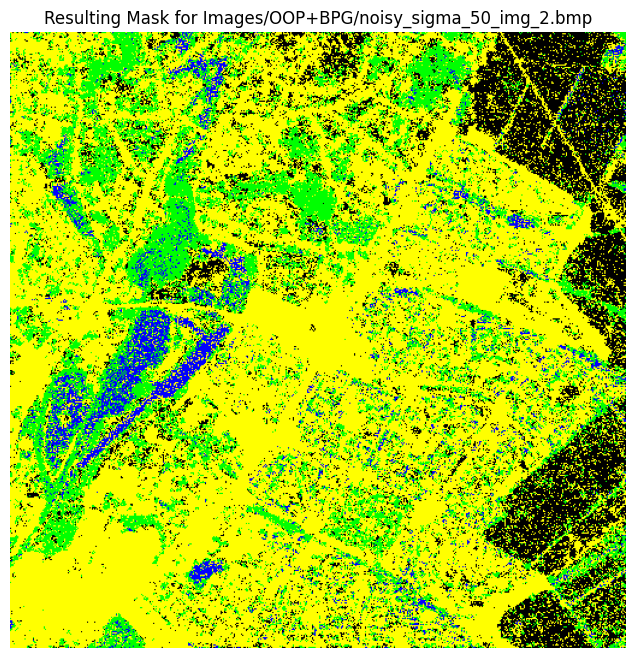

Result saved to: Images/temp/result_colored_mask_noisy_sigma_50_img_2.bmp
Evaluation Accuracy on Eval Image: 77.33%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.91      0.45      0.60      7117      
1         0.44      0.81      0.57      6032      
2         0.95      0.64      0.77      19125     
3         0.80      0.94      0.87      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.77      0.71      0.70      60314     
Weighted Avg0.83      0.77      0.77      60314     
Image to classify is reconstructed_q31_sigma_50_img_2.png


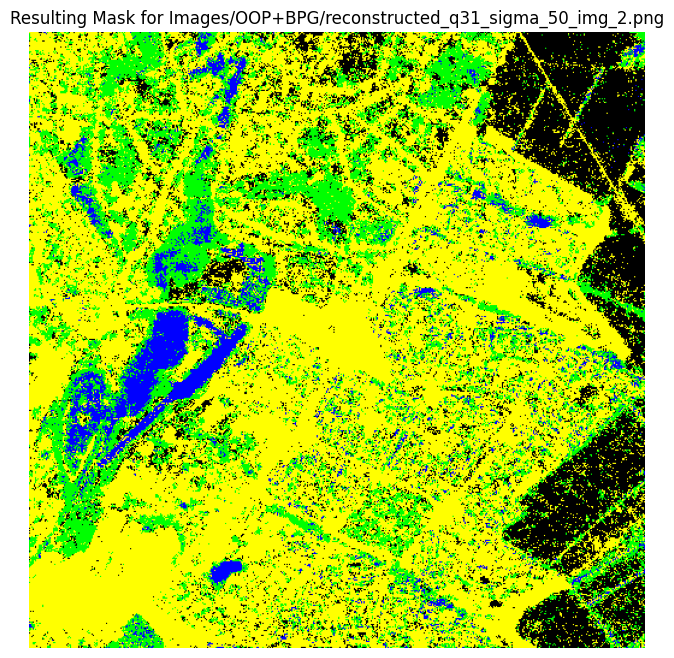

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_50_img_2.png
Evaluation Accuracy on Eval Image: 82.70%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.93      0.64      0.76      7117      
1         0.48      0.85      0.61      6032      
2         0.95      0.73      0.83      19125     
3         0.88      0.93      0.90      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.81      0.79      0.77      60314     
Weighted Avg0.87      0.83      0.83      60314     
Image to classify is reconstructed_q35_sigma_50_img_2.png


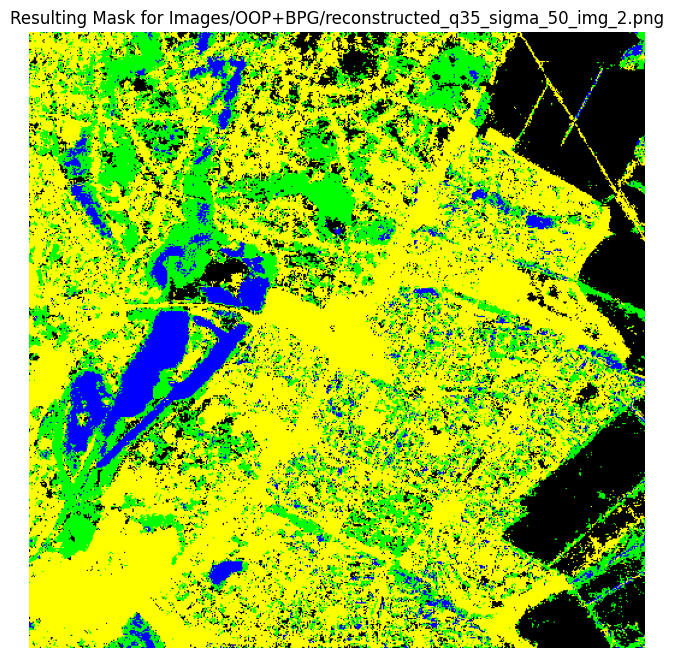

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_50_img_2.png
Evaluation Accuracy on Eval Image: 88.33%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.92      0.73      0.81      7117      
1         0.55      0.97      0.70      6032      
2         0.96      0.85      0.90      19125     
3         0.96      0.93      0.94      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.85      0.87      0.84      60314     
Weighted Avg0.91      0.88      0.89      60314     
Time taken for SS2, sigma^2=50, training on reconstructed_q35_sigma_50_img_2.png: 349.92 seconds

=== Processing for sigma^2 = 100, Case: SS1 ===

Training model using Images/OOP+BPG/noisy_sigma_100_img_1.bmp


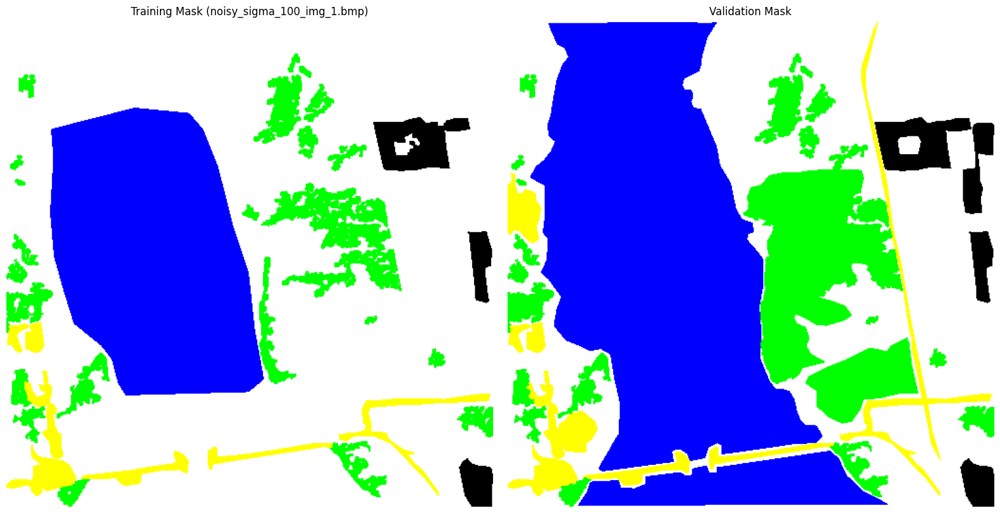

Accuracy: 96.59%
Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     15738
           1       0.96      0.96      0.96      5940
           2       0.85      0.84      0.84      1909
           3       0.89      0.87      0.88      2208

    accuracy                           0.97     25795
   macro avg       0.92      0.92      0.92     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: noisy_sigma_100_img_1.bmp
Image to classify is noisy_sigma_100_img_1.bmp


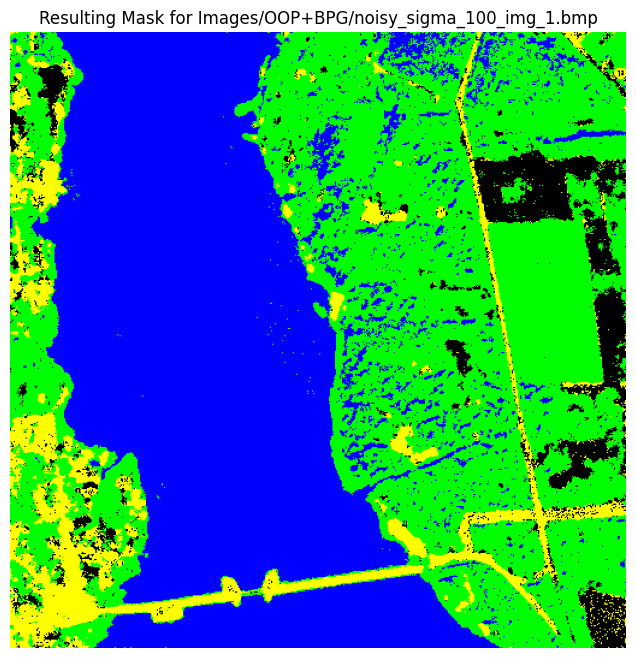

Result saved to: Images/temp/result_colored_mask_noisy_sigma_100_img_1.bmp
Evaluation Accuracy on Eval Image: 95.65%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.97      1.00      0.98      96852     
1         0.96      0.90      0.93      38258     
2         0.84      0.90      0.87      7898      
3         0.95      0.83      0.89      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.93      0.91      0.92      155162    
Weighted Avg0.96      0.96      0.96      155162    
Image to classify is reconstructed_q31_sigma_100_img_1.png


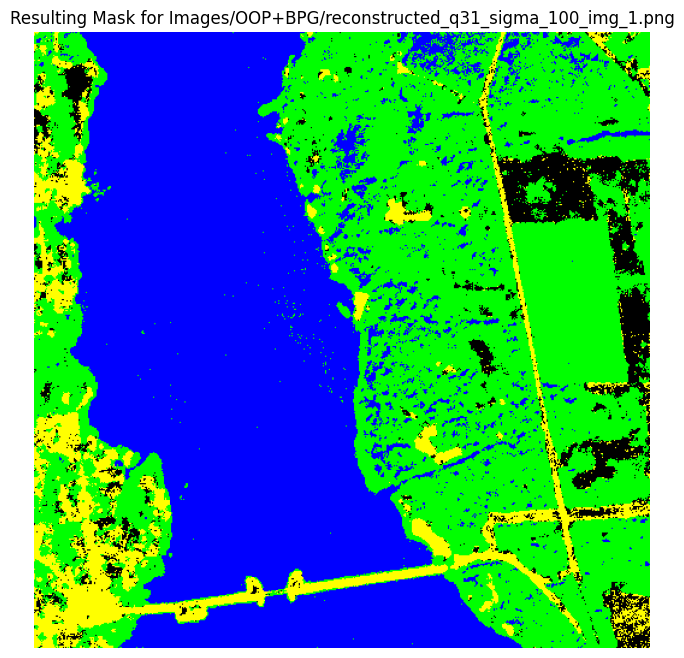

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_100_img_1.png
Evaluation Accuracy on Eval Image: 94.83%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.97      1.00      0.98      96852     
1         0.94      0.91      0.92      38258     
2         0.78      0.81      0.79      7898      
3         0.90      0.79      0.84      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.90      0.88      0.89      155162    
Weighted Avg0.95      0.95      0.95      155162    
Image to classify is reconstructed_q35_sigma_100_img_1.png


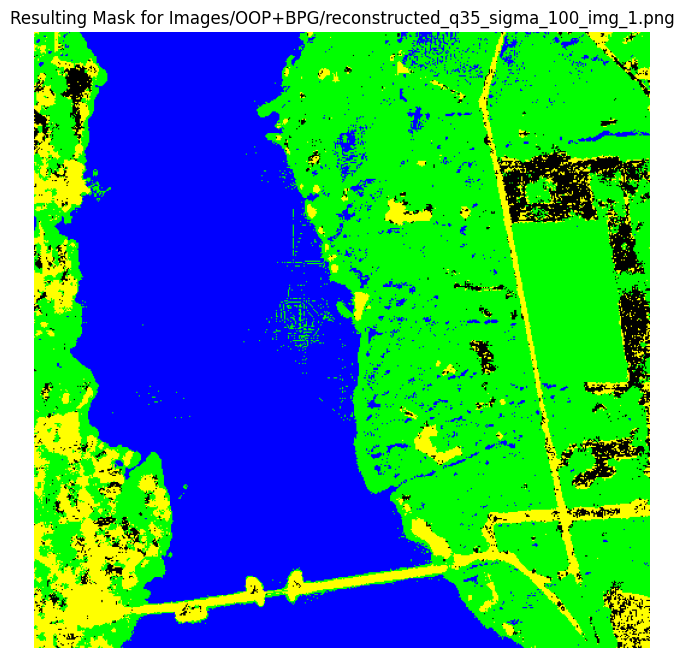

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_100_img_1.png
Evaluation Accuracy on Eval Image: 95.13%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      0.99      0.99      96852     
1         0.93      0.95      0.94      38258     
2         0.81      0.66      0.73      7898      
3         0.81      0.84      0.83      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.89      0.86      0.87      155162    
Weighted Avg0.95      0.95      0.95      155162    
Time taken for SS1, sigma^2=100, training on noisy_sigma_100_img_1.bmp: 359.51 seconds

Training model using Images/OOP+BPG/reconstructed_q31_sigma_100_img_1.png


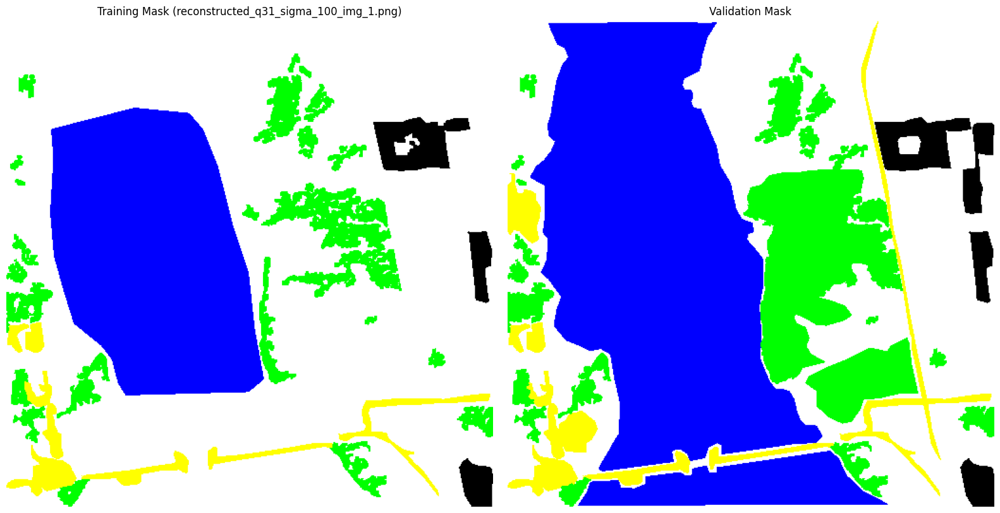

Accuracy: 96.70%
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15718
           1       0.95      0.97      0.96      5891
           2       0.86      0.84      0.85      1961
           3       0.89      0.87      0.88      2225

    accuracy                           0.97     25795
   macro avg       0.93      0.92      0.92     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: reconstructed_q31_sigma_100_img_1.png
Image to classify is noisy_sigma_100_img_1.bmp


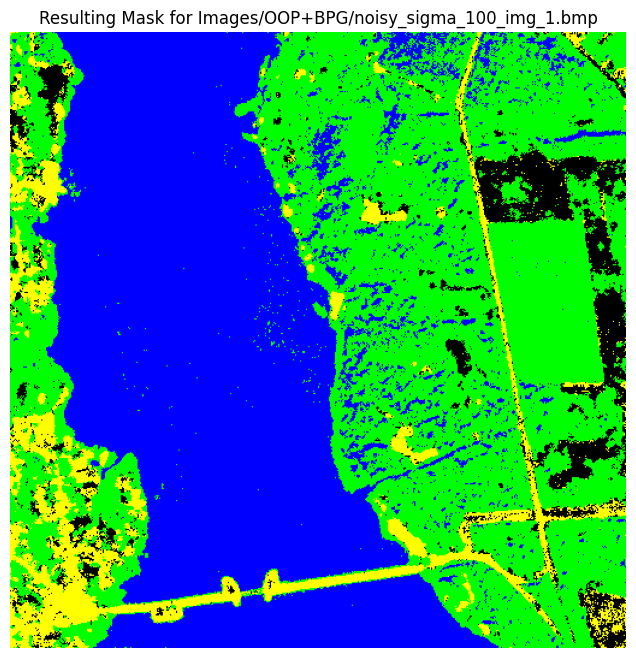

Result saved to: Images/temp/result_colored_mask_noisy_sigma_100_img_1.bmp
Evaluation Accuracy on Eval Image: 94.31%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.96      1.00      0.98      96852     
1         0.94      0.89      0.91      38258     
2         0.76      0.82      0.79      7898      
3         0.91      0.78      0.84      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.89      0.87      0.88      155162    
Weighted Avg0.94      0.94      0.94      155162    
Image to classify is reconstructed_q31_sigma_100_img_1.png


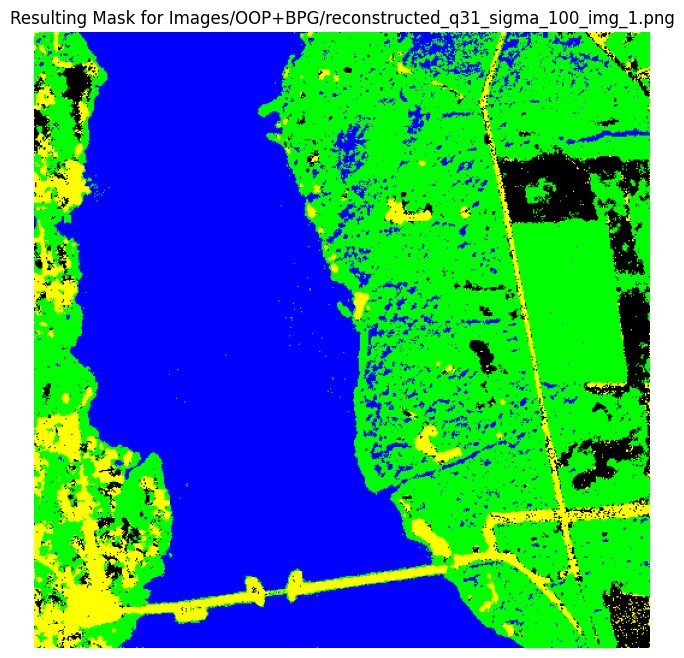

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_100_img_1.png
Evaluation Accuracy on Eval Image: 95.88%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.97      1.00      0.98      96852     
1         0.96      0.91      0.93      38258     
2         0.84      0.89      0.86      7898      
3         0.95      0.84      0.89      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.93      0.91      0.92      155162    
Weighted Avg0.96      0.96      0.96      155162    
Image to classify is reconstructed_q35_sigma_100_img_1.png


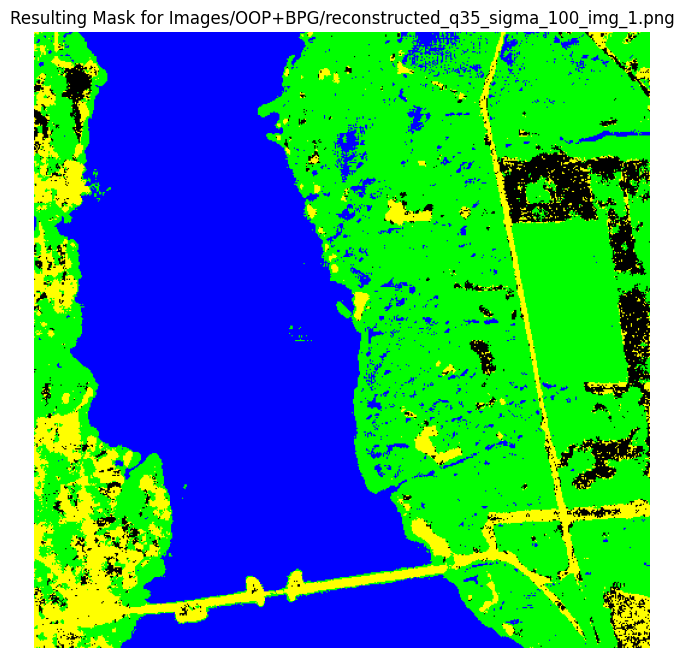

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_100_img_1.png
Evaluation Accuracy on Eval Image: 95.60%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.98      1.00      0.99      96852     
1         0.95      0.94      0.94      38258     
2         0.81      0.71      0.76      7898      
3         0.84      0.84      0.84      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.90      0.87      0.88      155162    
Weighted Avg0.95      0.96      0.96      155162    
Time taken for SS1, sigma^2=100, training on reconstructed_q31_sigma_100_img_1.png: 346.55 seconds

Training model using Images/OOP+BPG/reconstructed_q35_sigma_100_img_1.png


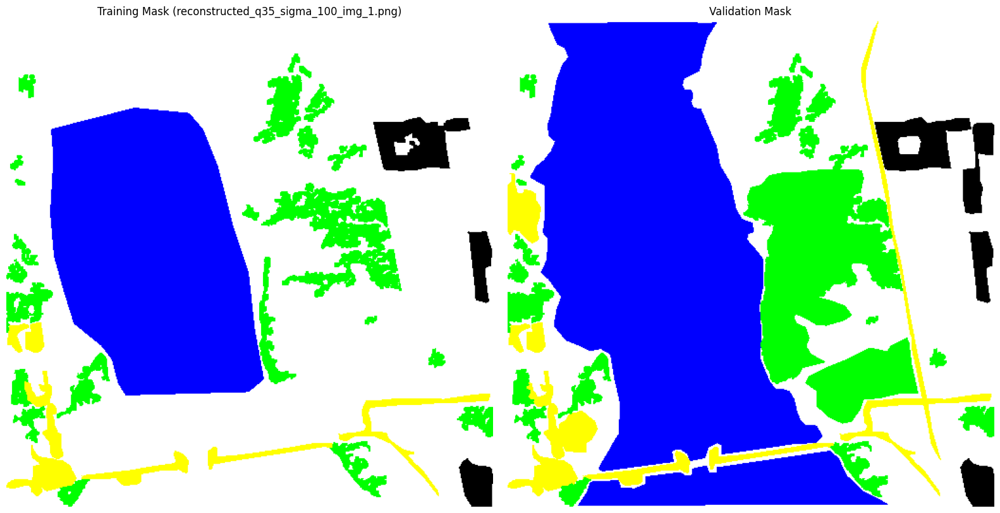

Accuracy: 97.34%
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15827
           1       0.97      0.98      0.97      5871
           2       0.86      0.86      0.86      1877
           3       0.90      0.88      0.89      2220

    accuracy                           0.97     25795
   macro avg       0.93      0.93      0.93     25795
weighted avg       0.97      0.97      0.97     25795

Model trained with: reconstructed_q35_sigma_100_img_1.png
Image to classify is noisy_sigma_100_img_1.bmp


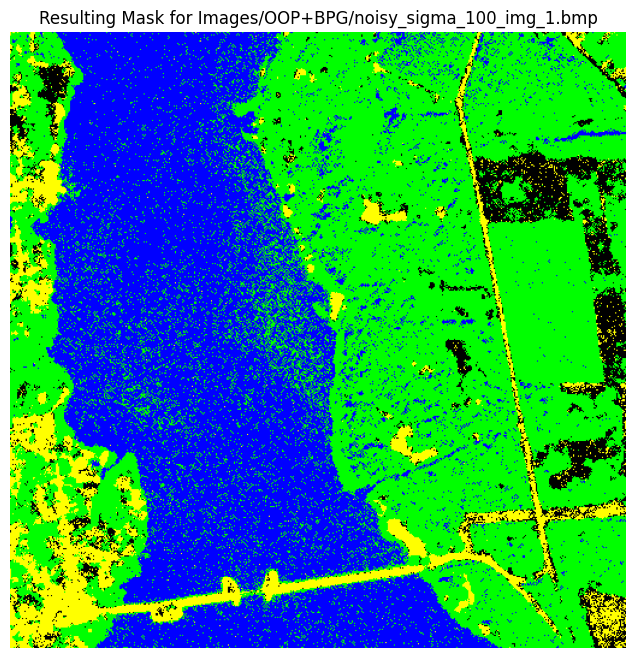

Result saved to: Images/temp/result_colored_mask_noisy_sigma_100_img_1.bmp
Evaluation Accuracy on Eval Image: 87.21%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.98      0.88      0.92      96852     
1         0.71      0.93      0.81      38258     
2         0.73      0.72      0.73      7898      
3         0.86      0.77      0.81      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.82      0.82      0.82      155162    
Weighted Avg0.89      0.87      0.88      155162    
Image to classify is reconstructed_q31_sigma_100_img_1.png


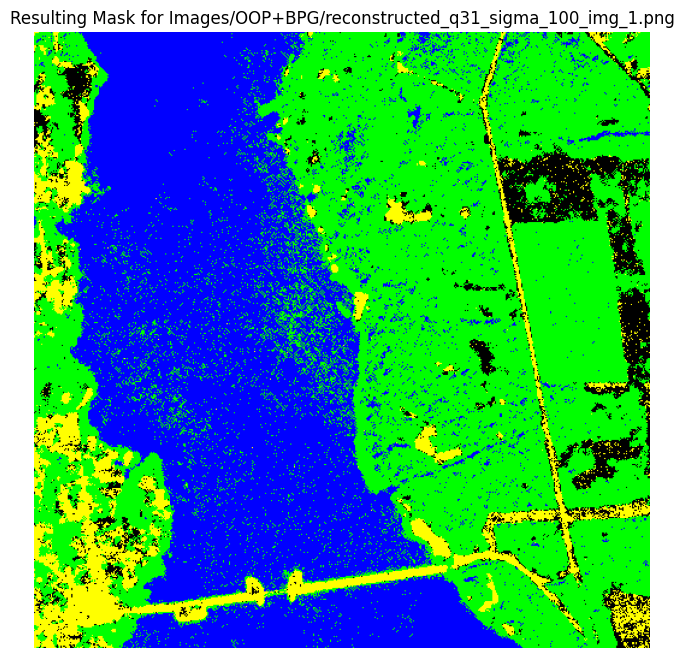

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_100_img_1.png
Evaluation Accuracy on Eval Image: 90.48%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.98      0.92      0.95      96852     
1         0.79      0.94      0.86      38258     
2         0.74      0.75      0.74      7898      
3         0.87      0.77      0.82      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.85      0.84      0.84      155162    
Weighted Avg0.91      0.90      0.91      155162    
Image to classify is reconstructed_q35_sigma_100_img_1.png


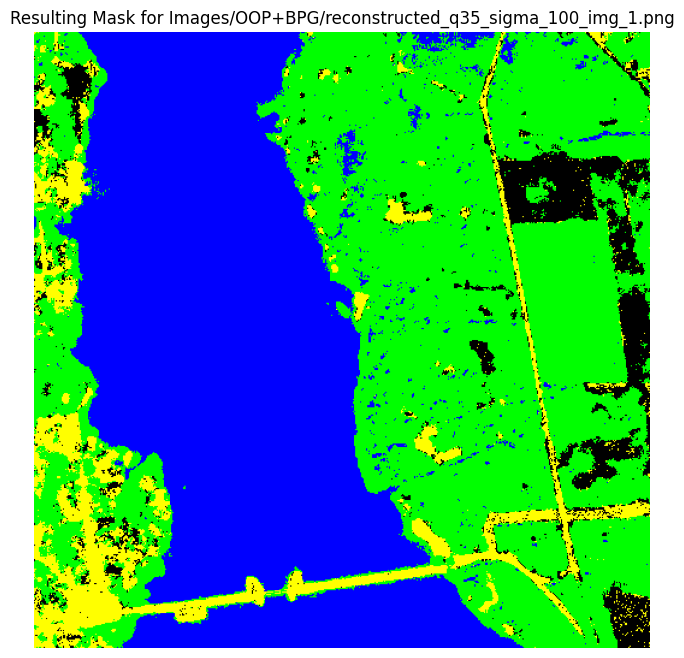

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_100_img_1.png
Evaluation Accuracy on Eval Image: 97.29%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.99      1.00      0.99      96852     
1         0.96      0.97      0.96      38258     
2         0.84      0.90      0.87      7898      
3         0.96      0.83      0.89      12154     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.94      0.93      0.93      155162    
Weighted Avg0.97      0.97      0.97      155162    
Time taken for SS1, sigma^2=100, training on reconstructed_q35_sigma_100_img_1.png: 334.14 seconds

=== Processing for sigma^2 = 100, Case: SS2 ===

Training model using Images/OOP+BPG/noisy_sigma_100_img_2.bmp


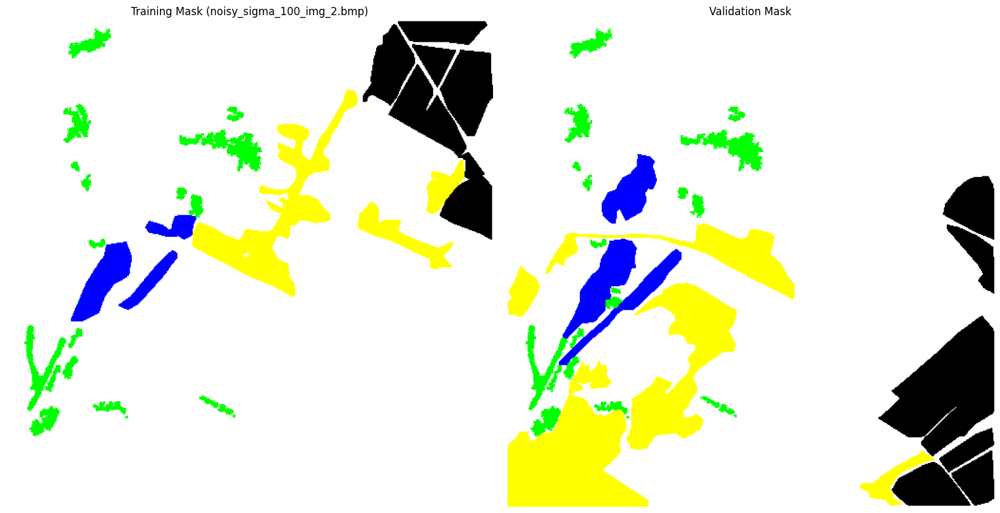

Accuracy: 89.57%
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      1280
           1       0.80      0.78      0.79      1807
           2       0.91      0.95      0.93      4518
           3       0.93      0.89      0.91      3419

    accuracy                           0.90     11024
   macro avg       0.88      0.88      0.88     11024
weighted avg       0.90      0.90      0.90     11024

Model trained with: noisy_sigma_100_img_2.bmp
Image to classify is noisy_sigma_100_img_2.bmp


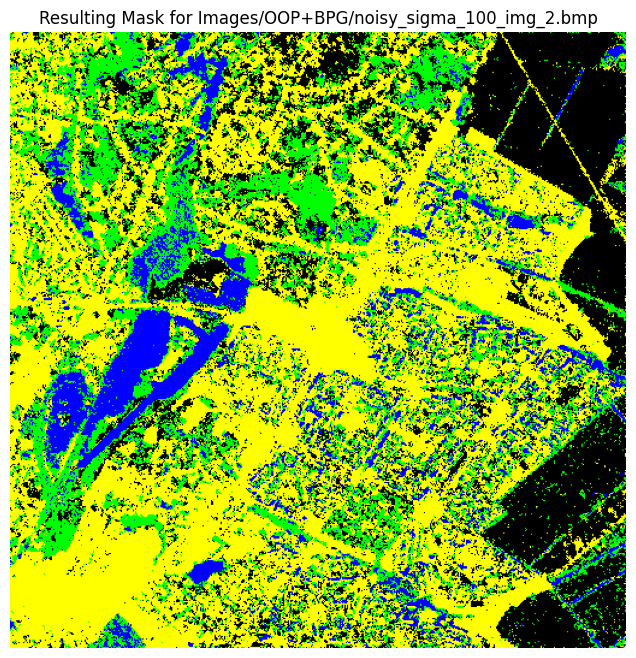

Result saved to: Images/temp/result_colored_mask_noisy_sigma_100_img_2.bmp
Evaluation Accuracy on Eval Image: 87.96%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.88      0.77      0.82      7117      
1         0.57      0.93      0.71      6032      
2         0.93      0.87      0.90      19125     
3         0.96      0.91      0.93      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.83      0.87      0.84      60314     
Weighted Avg0.90      0.88      0.89      60314     
Image to classify is reconstructed_q31_sigma_100_img_2.png


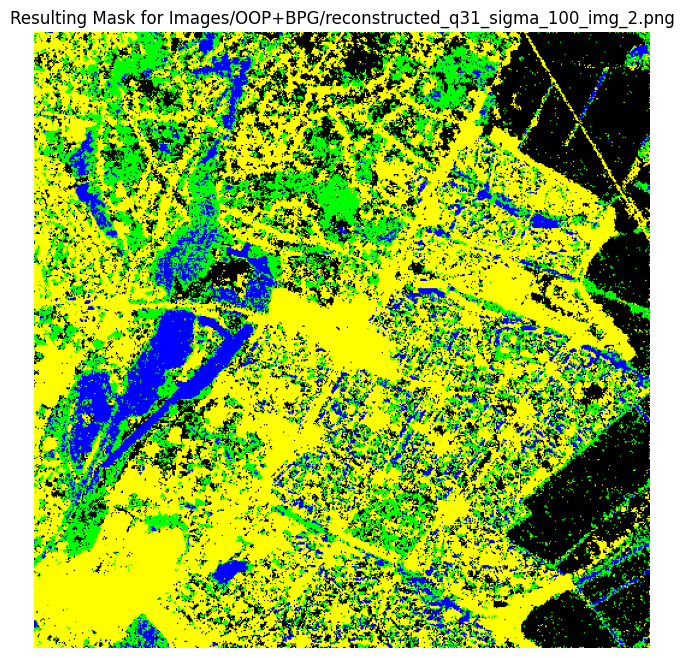

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_100_img_2.png
Evaluation Accuracy on Eval Image: 86.24%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.85      0.75      0.80      7117      
1         0.52      0.79      0.63      6032      
2         0.90      0.87      0.88      19125     
3         0.96      0.90      0.93      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.81      0.83      0.81      60314     
Weighted Avg0.88      0.86      0.87      60314     
Image to classify is reconstructed_q35_sigma_100_img_2.png


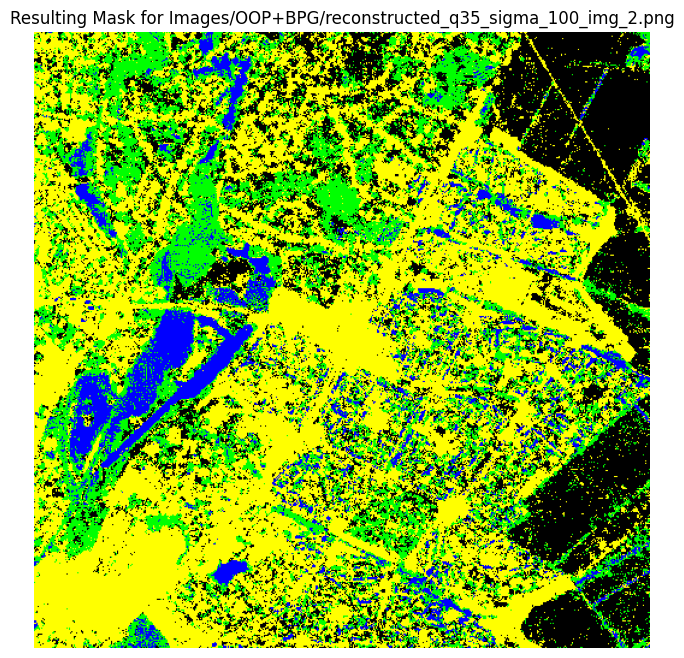

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_100_img_2.png
Evaluation Accuracy on Eval Image: 84.19%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.86      0.63      0.73      7117      
1         0.47      0.81      0.60      6032      
2         0.91      0.84      0.87      19125     
3         0.93      0.90      0.92      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.79      0.80      0.78      60314     
Weighted Avg0.87      0.84      0.85      60314     
Time taken for SS2, sigma^2=100, training on noisy_sigma_100_img_2.bmp: 358.06 seconds

Training model using Images/OOP+BPG/reconstructed_q31_sigma_100_img_2.png


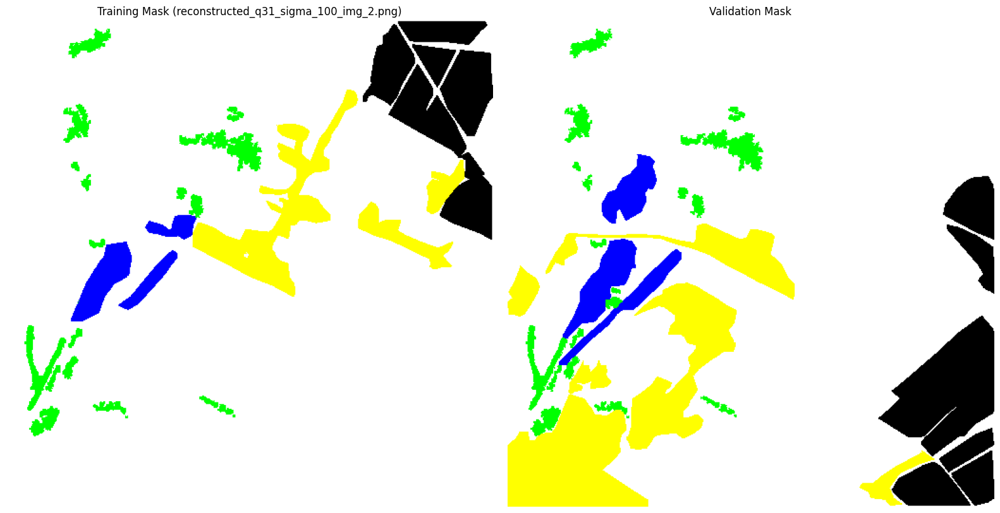

Accuracy: 89.74%
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.91      0.89      1242
           1       0.81      0.77      0.79      1843
           2       0.91      0.95      0.93      4522
           3       0.93      0.90      0.91      3417

    accuracy                           0.90     11024
   macro avg       0.88      0.88      0.88     11024
weighted avg       0.90      0.90      0.90     11024

Model trained with: reconstructed_q31_sigma_100_img_2.png
Image to classify is noisy_sigma_100_img_2.bmp


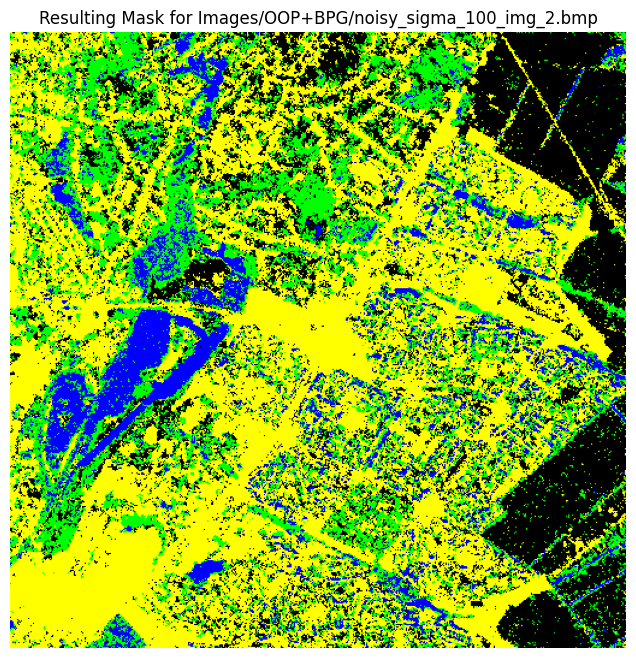

Result saved to: Images/temp/result_colored_mask_noisy_sigma_100_img_2.bmp
Evaluation Accuracy on Eval Image: 85.56%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.84      0.73      0.78      7117      
1         0.51      0.78      0.61      6032      
2         0.90      0.86      0.88      19125     
3         0.95      0.90      0.93      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.80      0.82      0.80      60314     
Weighted Avg0.88      0.86      0.86      60314     
Image to classify is reconstructed_q31_sigma_100_img_2.png


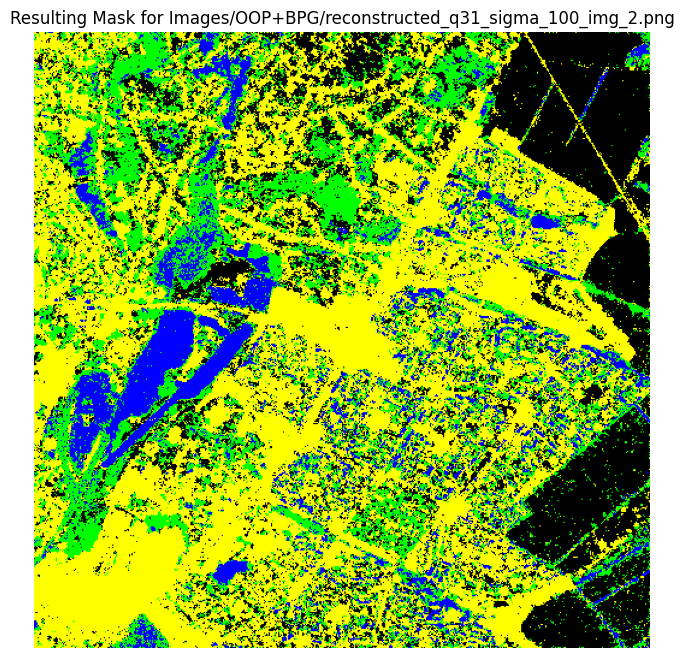

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_100_img_2.png
Evaluation Accuracy on Eval Image: 87.85%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.87      0.77      0.82      7117      
1         0.58      0.93      0.71      6032      
2         0.92      0.87      0.89      19125     
3         0.96      0.90      0.93      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.83      0.87      0.84      60314     
Weighted Avg0.90      0.88      0.88      60314     
Image to classify is reconstructed_q35_sigma_100_img_2.png


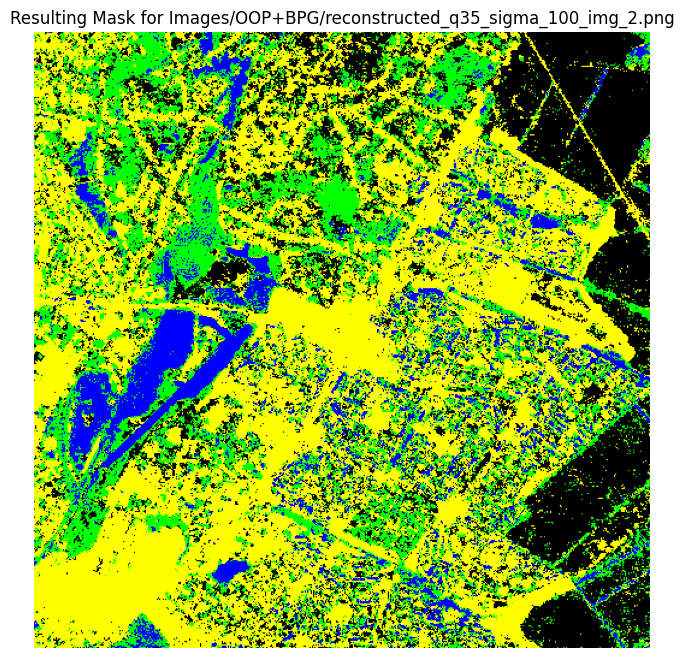

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_100_img_2.png
Evaluation Accuracy on Eval Image: 85.09%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.84      0.69      0.76      7117      
1         0.50      0.82      0.62      6032      
2         0.91      0.85      0.88      19125     
3         0.95      0.90      0.92      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.80      0.82      0.79      60314     
Weighted Avg0.88      0.85      0.86      60314     
Time taken for SS2, sigma^2=100, training on reconstructed_q31_sigma_100_img_2.png: 327.15 seconds

Training model using Images/OOP+BPG/reconstructed_q35_sigma_100_img_2.png


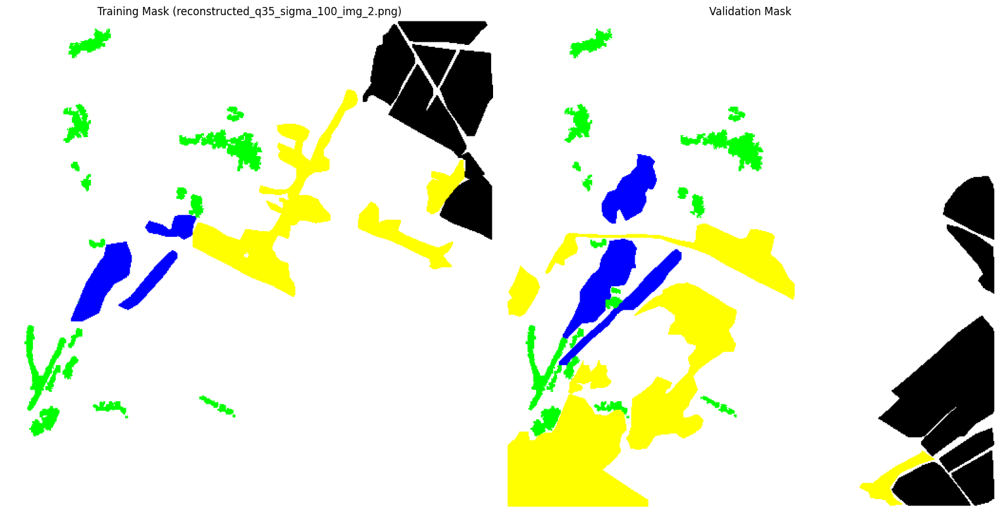

Accuracy: 91.96%
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.93      0.93      1288
           1       0.86      0.85      0.85      1866
           2       0.94      0.95      0.94      4450
           3       0.93      0.92      0.92      3420

    accuracy                           0.92     11024
   macro avg       0.91      0.91      0.91     11024
weighted avg       0.92      0.92      0.92     11024

Model trained with: reconstructed_q35_sigma_100_img_2.png
Image to classify is noisy_sigma_100_img_2.bmp


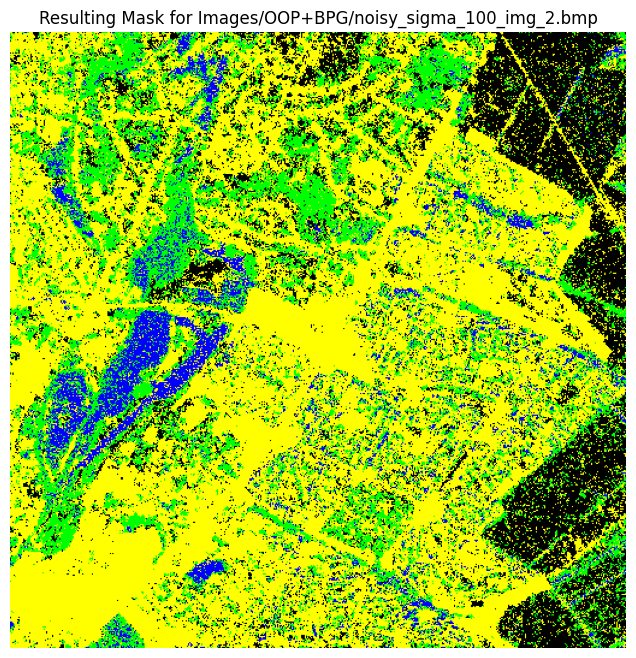

Result saved to: Images/temp/result_colored_mask_noisy_sigma_100_img_2.bmp
Evaluation Accuracy on Eval Image: 80.05%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.87      0.57      0.69      7117      
1         0.44      0.78      0.56      6032      
2         0.92      0.71      0.80      19125     
3         0.86      0.93      0.89      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.77      0.75      0.74      60314     
Weighted Avg0.84      0.80      0.81      60314     
Image to classify is reconstructed_q31_sigma_100_img_2.png


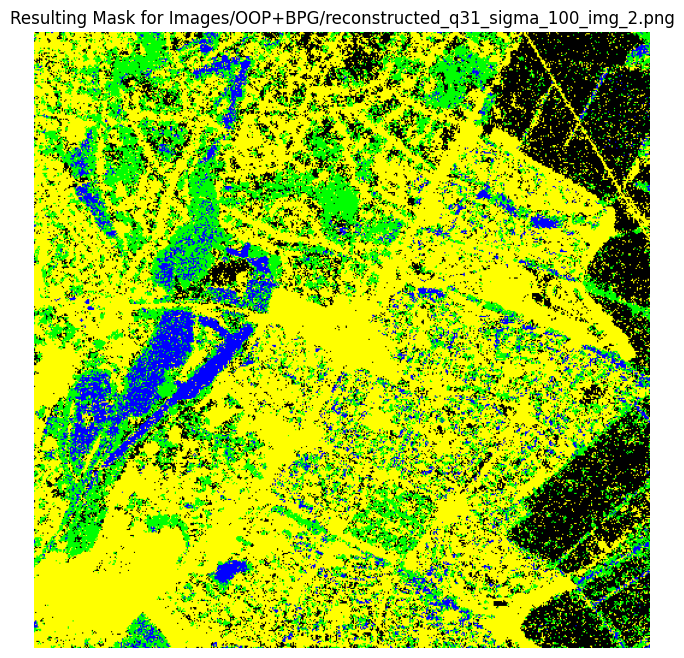

Result saved to: Images/temp/result_colored_mask_reconstructed_q31_sigma_100_img_2.png
Evaluation Accuracy on Eval Image: 81.45%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.86      0.62      0.72      7117      
1         0.44      0.80      0.57      6032      
2         0.92      0.73      0.82      19125     
3         0.89      0.92      0.91      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.78      0.77      0.75      60314     
Weighted Avg0.85      0.81      0.82      60314     
Image to classify is reconstructed_q35_sigma_100_img_2.png


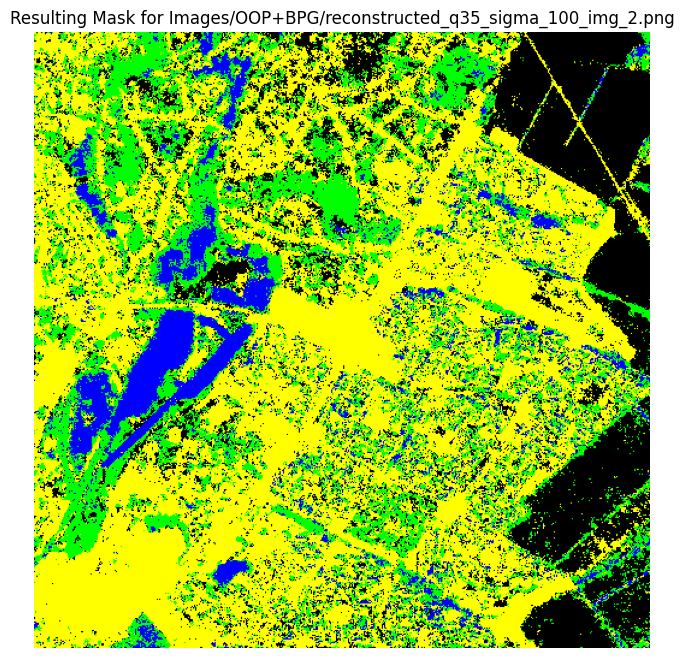

Result saved to: Images/temp/result_colored_mask_reconstructed_q35_sigma_100_img_2.png
Evaluation Accuracy on Eval Image: 88.39%
Evaluation Classification Report:
Class     Precision Recall    F1-Score  Support   
--------------------------------------------------
0         0.91      0.80      0.85      7117      
1         0.57      0.95      0.71      6032      
2         0.94      0.85      0.89      19125     
3         0.96      0.91      0.94      28040     

Overall Metrics:
Metric    Precision Recall    F1-Score  Support   
--------------------------------------------------
Macro Avg 0.85      0.88      0.85      60314     
Weighted Avg0.91      0.88      0.89      60314     
Time taken for SS2, sigma^2=100, training on reconstructed_q35_sigma_100_img_2.png: 329.83 seconds

=== Classification Results for SS1 ===

=== Classification Results for SS2 ===

=== Classification Results for SS1 ===
| Case | sigma^2 | Training Images                                  | Classified Image  

KeyError: 'Training Images'

In [133]:
if __name__ == "__main__":
    # All sigma cases to process
    sigma_values = [25, 50, 100]

    # SS1 and SS2 Mask Paths
    ss1_mask_train = "Images/sentinel/SS1/Samples1.bmp"
    ss1_mask_eval = "Images/sentinel/SS1/Etalon1.bmp"
    ss2_mask_train = "Images/sentinel/SS2/Samples2.bmp"
    ss2_mask_eval = "Images/sentinel/SS2/Etalon2.bmp"

    # Separate results storage for SS1 and SS2
    all_results_ss1 = []
    all_results_ss2 = []

    for sigma in sigma_values:
        # === SS1 Case ===
        print(f"\n=== Processing for sigma^2 = {sigma}, Case: SS1 ===")
        train_image_paths_ss1 = [
            f"Images/OOP+BPG/noisy_sigma_{sigma}_img_1.bmp",  # Noisy image
            f"Images/OOP+BPG/reconstructed_q31_sigma_{sigma}_img_1.png",  # Reconstructed (Q=31)
            f"Images/OOP+BPG/reconstructed_q35_sigma_{sigma}_img_1.png"   # Reconstructed (Q=35)
        ]
        validation_image_paths_ss1 = train_image_paths_ss1  # All images are used for validation

        # Train and validate per training image
        for train_image_path in train_image_paths_ss1:
            results_ss1 = process_sigma_case(
                case="SS1",
                sigma=sigma,
                train_image_path=train_image_path,
                train_mask_path=ss1_mask_train,
                eval_mask_path=ss1_mask_eval,
                validation_image_paths=validation_image_paths_ss1
            )
            all_results_ss1.extend(results_ss1)

        # === SS2 Case ===
        print(f"\n=== Processing for sigma^2 = {sigma}, Case: SS2 ===")
        train_image_paths_ss2 = [
            f"Images/OOP+BPG/noisy_sigma_{sigma}_img_2.bmp",  # Noisy image
            f"Images/OOP+BPG/reconstructed_q31_sigma_{sigma}_img_2.png",  # Reconstructed (Q=31)
            f"Images/OOP+BPG/reconstructed_q35_sigma_{sigma}_img_2.png"   # Reconstructed (Q=35)
        ]
        validation_image_paths_ss2 = train_image_paths_ss2  # All images are used for validation

        # Train and validate per training image
        for train_image_path in train_image_paths_ss2:
            results_ss2 = process_sigma_case(
                case="SS2",
                sigma=sigma,
                train_image_path=train_image_path,
                train_mask_path=ss2_mask_train,
                eval_mask_path=ss2_mask_eval,
                validation_image_paths=validation_image_paths_ss2
            )
            all_results_ss2.extend(results_ss2)
     

    # === Generate Separate Tables ===

    # Table for SS1 Results
    print("\n=== Classification Results for SS1 ===")
    print("| Case | sigma^2 | Training Images                                  | Classified Image                  | F1 class 3 (Urban) | F1 class 0 (Water) | F1 class 1 (Vegetation) | F1 class 2 ((Open Ground)) | F1 Total |")
    print("|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|")
    
    for result in all_results_ss1:
        try:
            f1_class_3 = float(result.get('F1-Score class 3', 0))
            f1_class_0 = float(result.get('F1-Score class 0', 0))
            f1_class_1 = float(result.get('F1-Score class 1', 0))
            f1_class_2 = float(result.get('F1-Score class 2', 0))
            f1_total = float(result.get('F1 Total', 0))
        except ValueError as e:
            print(f"Error converting results for: {result['Case']} {result['sigma^2']}. Defaulting to 0. Details: {e}")
            f1_class_3, f1_class_0, f1_class_1, f1_class_2, f1_total = 0, 0, 0, 0, 0  # Default fallback values
    
        #training_images_str = ', '.join(result["Training Images"])
        training_images_str = result["Training Image"]
        print(f"| {result['Case']} | {result['sigma^2']} | {training_images_str} | {result['Classified Image']} | "
              f"{f1_class_3:.2f} | {f1_class_0:.2f} | {f1_class_1:.2f} | {f1_class_2:.2f} | {f1_total:.2f} |")
    
    # Table for SS2 Results
    print("\n=== Classification Results for SS2 ===")
    print("| Case | sigma^2 | Training Images                                  | Classified Image                  | F1 class 3 (Urban) | F1 class 0 (Water) | F1 class 1 (Vegetation) | F1 class 2 (Open Ground) | F1 Total |")
    print("|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|")
    
    for result in all_results_ss2:
        try:
            f1_class_3 = float(result.get('F1-Score class 3', 0))
            f1_class_0 = float(result.get('F1-Score class 0', 0))
            f1_class_1 = float(result.get('F1-Score class 1', 0))
            f1_class_2 = float(result.get('F1-Score class 2', 0))
            f1_total = float(result.get('F1 Total', 0))
        except ValueError as e:
            print(f"Error converting results for: {result['Case']} {result['sigma^2']}. Defaulting to 0. Details: {e}")
            f1_class_3, f1_class_0, f1_class_1, f1_class_2, f1_total = 0, 0, 0, 0, 0  # Default fallback values
    
        #training_images_str = ', '.join(result["Training Images"])
        training_images_str = result["Training Image"]
        print(f"| {result['Case']} | {result['sigma^2']} | {training_images_str} | {result['Classified Image']} | "
              f"{f1_class_3:.2f} | {f1_class_0:.2f} | {f1_class_1:.2f} | {f1_class_2:.2f} | {f1_total:.2f} |")

In [139]:
# === Generate Separate Tables ===

# Table for SS1 Results
print("\n=== Classification Results for SS1 ===")
print("| Case | sigma^2 | Training Images                                  | Classified Image                  | F1 class 3 (Urbanization) | F1 class 0 (Water) | F1 class 1 (Vegetation) | F1 class 2 ((Open Ground)) | F1 Total |")
print("|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|")

for result in all_results_ss1:
    try:
        f1_class_3 = float(result.get('F1-Score class 3', 0))
        f1_class_0 = float(result.get('F1-Score class 0', 0))
        f1_class_1 = float(result.get('F1-Score class 1', 0))
        f1_class_2 = float(result.get('F1-Score class 2', 0))
        f1_total = float(result.get('F1 Total', 0))
    except ValueError as e:
        print(f"Error converting results for: {result['Case']} {result['sigma^2']}. Defaulting to 0. Details: {e}")
        f1_class_3, f1_class_0, f1_class_1, f1_class_2, f1_total = 0, 0, 0, 0, 0  # Default fallback values

    #training_images_str = ', '.join(result["Training Images"])
    training_images_str = result["Training Image"]
    print(f"| {result['Case']} | {result['sigma^2']} | {training_images_str} | {result['Classified Image']} | "
          f"{f1_class_3:.2f} | {f1_class_0:.2f} | {f1_class_1:.2f} | {f1_class_2:.2f} | {f1_total:.2f} |")

# Table for SS2 Results
print("\n=== Classification Results for SS2 ===")
print("| Case | sigma^2 | Training Images                                  | Classified Image                  | F1 class 3 (Urbanization) | F1 class 0 (Water) | F1 class 1 (Vegetation) | F1 class 2 (Open Ground) | F1 Total |")
print("|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|")

for result in all_results_ss2:
    try:
        f1_class_3 = float(result.get('F1-Score class 3', 0))
        f1_class_0 = float(result.get('F1-Score class 0', 0))
        f1_class_1 = float(result.get('F1-Score class 1', 0))
        f1_class_2 = float(result.get('F1-Score class 2', 0))
        f1_total = float(result.get('F1 Total', 0))
    except ValueError as e:
        print(f"Error converting results for: {result['Case']} {result['sigma^2']}. Defaulting to 0. Details: {e}")
        f1_class_3, f1_class_0, f1_class_1, f1_class_2, f1_total = 0, 0, 0, 0, 0  # Default fallback values

    #training_images_str = ', '.join(result["Training Images"])
    training_images_str = result["Training Image"]
    print(f"| {result['Case']} | {result['sigma^2']} | {training_images_str} | {result['Classified Image']} | "
          f"{f1_class_3:.2f} | {f1_class_0:.2f} | {f1_class_1:.2f} | {f1_class_2:.2f} | {f1_total:.2f} |")


=== Classification Results for SS1 ===
| Case | sigma^2 | Training Images                                  | Classified Image                  | F1 class 3 (Urbanization) | F1 class 0 (Water) | F1 class 1 (Vegetation) | F1 class 2 ((Open Ground)) | F1 Total |
|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|
| SS1 | 25 | noisy_sigma_25_img_1.bmp | noisy_sigma_25_img_1.bmp | 0.90 | 0.99 | 0.94 | 0.88 | 0.93 |
| SS1 | 25 | noisy_sigma_25_img_1.bmp | reconstructed_q31_sigma_25_img_1.png | 0.85 | 0.99 | 0.95 | 0.79 | 0.89 |
| SS1 | 25 | noisy_sigma_25_img_1.bmp | reconstructed_q35_sigma_25_img_1.png | 0.85 | 0.99 | 0.95 | 0.79 | 0.90 |
| SS1 | 25 | reconstructed_q31_sigma_25_img_1.png | noisy_sigma_25_img_1.bmp | 0.84 | 0.97 | 0.90 | 0.77 | 0.87 |
| SS1 | 25 | reconstructed_q31_sigma_25_img_1.png | reconstructed_q31_sigma_25_img_1.png | 0.90 | 0.99 |

=== Classification Results for SS1 ===
| Case | sigma^2 | Training Images                                  | Classified Image                  | F1 class 3 (Urbanization) | F1 class 0 (Water) | F1 class 1 (Vegetation) | F1 class 2 ((Open Ground)) | F1 Total |
|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|
| SS1 | 25 | noisy_sigma_25_img_1.bmp | noisy_sigma_25_img_1.bmp | 0.90 | 0.99 | 0.94 | 0.88 | 0.93 |
| SS1 | 25 | noisy_sigma_25_img_1.bmp | reconstructed_q31_sigma_25_img_1.png | 0.85 | 0.99 | 0.95 | 0.79 | 0.89 |
| SS1 | 25 | noisy_sigma_25_img_1.bmp | reconstructed_q35_sigma_25_img_1.png | 0.85 | 0.99 | 0.95 | 0.79 | 0.90 |
| SS1 | 25 | reconstructed_q31_sigma_25_img_1.png | noisy_sigma_25_img_1.bmp | 0.84 | 0.97 | 0.90 | 0.77 | 0.87 |
| SS1 | 25 | reconstructed_q31_sigma_25_img_1.png | reconstructed_q31_sigma_25_img_1.png | 0.90 | 0.99 | 0.96 | 0.88 | 0.93 |
| SS1 | 25 | reconstructed_q31_sigma_25_img_1.png | reconstructed_q35_sigma_25_img_1.png | 0.86 | 1.00 | 0.96 | 0.82 | 0.91 |
| SS1 | 25 | reconstructed_q35_sigma_25_img_1.png | noisy_sigma_25_img_1.bmp | 0.83 | 0.97 | 0.90 | 0.77 | 0.87 |
| SS1 | 25 | reconstructed_q35_sigma_25_img_1.png | reconstructed_q31_sigma_25_img_1.png | 0.85 | 0.99 | 0.95 | 0.81 | 0.90 |
| SS1 | 25 | reconstructed_q35_sigma_25_img_1.png | reconstructed_q35_sigma_25_img_1.png | 0.90 | 1.00 | 0.97 | 0.88 | 0.93 |
| SS1 | 50 | noisy_sigma_50_img_1.bmp | noisy_sigma_50_img_1.bmp | 0.90 | 0.99 | 0.94 | 0.87 | 0.92 |
| SS1 | 50 | noisy_sigma_50_img_1.bmp | reconstructed_q31_sigma_50_img_1.png | 0.85 | 0.99 | 0.94 | 0.80 | 0.90 |
| SS1 | 50 | noisy_sigma_50_img_1.bmp | reconstructed_q35_sigma_50_img_1.png | 0.84 | 0.99 | 0.95 | 0.75 | 0.88 |
| SS1 | 50 | reconstructed_q31_sigma_50_img_1.png | noisy_sigma_50_img_1.bmp | 0.84 | 0.97 | 0.89 | 0.79 | 0.87 |
| SS1 | 50 | reconstructed_q31_sigma_50_img_1.png | reconstructed_q31_sigma_50_img_1.png | 0.90 | 0.99 | 0.96 | 0.88 | 0.93 |
| SS1 | 50 | reconstructed_q31_sigma_50_img_1.png | reconstructed_q35_sigma_50_img_1.png | 0.85 | 0.99 | 0.95 | 0.80 | 0.90 |
| SS1 | 50 | reconstructed_q35_sigma_50_img_1.png | noisy_sigma_50_img_1.bmp | 0.82 | 0.94 | 0.85 | 0.74 | 0.84 |
| SS1 | 50 | reconstructed_q35_sigma_50_img_1.png | reconstructed_q31_sigma_50_img_1.png | 0.84 | 0.99 | 0.95 | 0.78 | 0.89 |
| SS1 | 50 | reconstructed_q35_sigma_50_img_1.png | reconstructed_q35_sigma_50_img_1.png | 0.90 | 1.00 | 0.97 | 0.88 | 0.94 |
| SS1 | 100 | noisy_sigma_100_img_1.bmp | noisy_sigma_100_img_1.bmp | 0.89 | 0.98 | 0.93 | 0.87 | 0.92 |
| SS1 | 100 | noisy_sigma_100_img_1.bmp | reconstructed_q31_sigma_100_img_1.png | 0.84 | 0.98 | 0.92 | 0.79 | 0.89 |
| SS1 | 100 | noisy_sigma_100_img_1.bmp | reconstructed_q35_sigma_100_img_1.png | 0.83 | 0.99 | 0.94 | 0.73 | 0.87 |
| SS1 | 100 | reconstructed_q31_sigma_100_img_1.png | noisy_sigma_100_img_1.bmp | 0.84 | 0.98 | 0.91 | 0.79 | 0.88 |
| SS1 | 100 | reconstructed_q31_sigma_100_img_1.png | reconstructed_q31_sigma_100_img_1.png | 0.89 | 0.98 | 0.93 | 0.86 | 0.92 |
| SS1 | 100 | reconstructed_q31_sigma_100_img_1.png | reconstructed_q35_sigma_100_img_1.png | 0.84 | 0.99 | 0.94 | 0.76 | 0.88 |
| SS1 | 100 | reconstructed_q35_sigma_100_img_1.png | noisy_sigma_100_img_1.bmp | 0.81 | 0.92 | 0.81 | 0.73 | 0.82 |
| SS1 | 100 | reconstructed_q35_sigma_100_img_1.png | reconstructed_q31_sigma_100_img_1.png | 0.82 | 0.95 | 0.86 | 0.74 | 0.84 |
| SS1 | 100 | reconstructed_q35_sigma_100_img_1.png | reconstructed_q35_sigma_100_img_1.png | 0.89 | 0.99 | 0.96 | 0.87 | 0.93 |

=== Classification Results for SS2 ===
| Case | sigma^2 | Training Images                                  | Classified Image                  | F1 class 3 (Urbanization) | F1 class 0 (Water) | F1 class 1 (Vegetation) | F1 class 2 (Open Ground) | F1 Total |
|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|
| SS2 | 25 | noisy_sigma_25_img_2.bmp | noisy_sigma_25_img_2.bmp | 0.94 | 0.79 | 0.72 | 0.91 | 0.84 |
| SS2 | 25 | noisy_sigma_25_img_2.bmp | reconstructed_q31_sigma_25_img_2.png | 0.93 | 0.76 | 0.66 | 0.90 | 0.81 |
| SS2 | 25 | noisy_sigma_25_img_2.bmp | reconstructed_q35_sigma_25_img_2.png | 0.92 | 0.75 | 0.66 | 0.90 | 0.81 |
| SS2 | 25 | reconstructed_q31_sigma_25_img_2.png | noisy_sigma_25_img_2.bmp | 0.91 | 0.69 | 0.62 | 0.85 | 0.77 |
| SS2 | 25 | reconstructed_q31_sigma_25_img_2.png | reconstructed_q31_sigma_25_img_2.png | 0.94 | 0.87 | 0.75 | 0.91 | 0.87 |
| SS2 | 25 | reconstructed_q31_sigma_25_img_2.png | reconstructed_q35_sigma_25_img_2.png | 0.94 | 0.86 | 0.73 | 0.92 | 0.86 |
| SS2 | 25 | reconstructed_q35_sigma_25_img_2.png | noisy_sigma_25_img_2.bmp | 0.85 | 0.68 | 0.59 | 0.73 | 0.71 |
| SS2 | 25 | reconstructed_q35_sigma_25_img_2.png | reconstructed_q31_sigma_25_img_2.png | 0.93 | 0.79 | 0.66 | 0.88 | 0.81 |
| SS2 | 25 | reconstructed_q35_sigma_25_img_2.png | reconstructed_q35_sigma_25_img_2.png | 0.94 | 0.79 | 0.71 | 0.91 | 0.84 |
| SS2 | 50 | noisy_sigma_50_img_2.bmp | noisy_sigma_50_img_2.bmp | 0.94 | 0.81 | 0.72 | 0.91 | 0.84 |
| SS2 | 50 | noisy_sigma_50_img_2.bmp | reconstructed_q31_sigma_50_img_2.png | 0.93 | 0.77 | 0.65 | 0.90 | 0.81 |
| SS2 | 50 | noisy_sigma_50_img_2.bmp | reconstructed_q35_sigma_50_img_2.png | 0.92 | 0.76 | 0.65 | 0.88 | 0.80 |
| SS2 | 50 | reconstructed_q31_sigma_50_img_2.png | noisy_sigma_50_img_2.bmp | 0.93 | 0.74 | 0.63 | 0.89 | 0.80 |
| SS2 | 50 | reconstructed_q31_sigma_50_img_2.png | reconstructed_q31_sigma_50_img_2.png | 0.94 | 0.82 | 0.71 | 0.90 | 0.84 |
| SS2 | 50 | reconstructed_q31_sigma_50_img_2.png | reconstructed_q35_sigma_50_img_2.png | 0.93 | 0.80 | 0.68 | 0.91 | 0.83 |
| SS2 | 50 | reconstructed_q35_sigma_50_img_2.png | noisy_sigma_50_img_2.bmp | 0.87 | 0.60 | 0.57 | 0.77 | 0.70 |
| SS2 | 50 | reconstructed_q35_sigma_50_img_2.png | reconstructed_q31_sigma_50_img_2.png | 0.90 | 0.76 | 0.61 | 0.83 | 0.77 |
| SS2 | 50 | reconstructed_q35_sigma_50_img_2.png | reconstructed_q35_sigma_50_img_2.png | 0.94 | 0.81 | 0.70 | 0.90 | 0.84 |
| SS2 | 100 | noisy_sigma_100_img_2.bmp | noisy_sigma_100_img_2.bmp | 0.93 | 0.82 | 0.71 | 0.90 | 0.84 |
| SS2 | 100 | noisy_sigma_100_img_2.bmp | reconstructed_q31_sigma_100_img_2.png | 0.93 | 0.80 | 0.63 | 0.88 | 0.81 |
| SS2 | 100 | noisy_sigma_100_img_2.bmp | reconstructed_q35_sigma_100_img_2.png | 0.92 | 0.73 | 0.60 | 0.87 | 0.78 |
| SS2 | 100 | reconstructed_q31_sigma_100_img_2.png | noisy_sigma_100_img_2.bmp | 0.93 | 0.78 | 0.61 | 0.88 | 0.80 |
| SS2 | 100 | reconstructed_q31_sigma_100_img_2.png | reconstructed_q31_sigma_100_img_2.png | 0.93 | 0.82 | 0.71 | 0.89 | 0.84 |
| SS2 | 100 | reconstructed_q31_sigma_100_img_2.png | reconstructed_q35_sigma_100_img_2.png | 0.92 | 0.76 | 0.62 | 0.88 | 0.79 |
| SS2 | 100 | reconstructed_q35_sigma_100_img_2.png | noisy_sigma_100_img_2.bmp | 0.89 | 0.69 | 0.56 | 0.80 | 0.74 |
| SS2 | 100 | reconstructed_q35_sigma_100_img_2.png | reconstructed_q31_sigma_100_img_2.png | 0.91 | 0.72 | 0.57 | 0.82 | 0.75 |
| SS2 | 100 | reconstructed_q35_sigma_100_img_2.png | reconstructed_q35_sigma_100_img_2.png | 0.94 | 0.85 | 0.71 | 0.89 | 0.85 |

# Case when we used all 3 images for model training

=== Classification Results for SS1 ===
| Case | sigma^2 | Training Images                                  | Classified Image                  | F1-Score class 3 | F1-Score class 0 | F1-Score class 1 | F1-Score class 2 | F1 Total |
|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|
| SS1 | 25 | noisy_sigma_25_img_1.bmp, reconstructed_q31_sigma_25_img_1.png, reconstructed_q35_sigma_25_img_1.png | noisy_sigma_25_img_1.bmp | 0.82 | 0.97 | 0.90 | 0.77 | 0.87 |
| SS1 | 25 | noisy_sigma_25_img_1.bmp, reconstructed_q31_sigma_25_img_1.png, reconstructed_q35_sigma_25_img_1.png | reconstructed_q31_sigma_25_img_1.png | 0.85 | 0.99 | 0.96 | 0.82 | 0.91 |
| SS1 | 25 | noisy_sigma_25_img_1.bmp, reconstructed_q31_sigma_25_img_1.png, reconstructed_q35_sigma_25_img_1.png | reconstructed_q35_sigma_25_img_1.png | 0.91 | 1.00 | 0.97 | 0.90 | 0.95 |
| SS1 | 50 | noisy_sigma_50_img_1.bmp, reconstructed_q31_sigma_50_img_1.png, reconstructed_q35_sigma_50_img_1.png | noisy_sigma_50_img_1.bmp | 0.83 | 0.94 | 0.84 | 0.74 | 0.84 |
| SS1 | 50 | noisy_sigma_50_img_1.bmp, reconstructed_q31_sigma_50_img_1.png, reconstructed_q35_sigma_50_img_1.png | reconstructed_q31_sigma_50_img_1.png | 0.84 | 0.99 | 0.95 | 0.78 | 0.89 |
| SS1 | 50 | noisy_sigma_50_img_1.bmp, reconstructed_q31_sigma_50_img_1.png, reconstructed_q35_sigma_50_img_1.png | reconstructed_q35_sigma_50_img_1.png | 0.91 | 1.00 | 0.97 | 0.90 | 0.94 |
| SS1 | 100 | noisy_sigma_100_img_1.bmp, reconstructed_q31_sigma_100_img_1.png, reconstructed_q35_sigma_100_img_1.png | noisy_sigma_100_img_1.bmp | 0.81 | 0.93 | 0.81 | 0.72 | 0.82 |
| SS1 | 100 | noisy_sigma_100_img_1.bmp, reconstructed_q31_sigma_100_img_1.png, reconstructed_q35_sigma_100_img_1.png | reconstructed_q31_sigma_100_img_1.png | 0.82 | 0.95 | 0.86 | 0.75 | 0.85 |
| SS1 | 100 | noisy_sigma_100_img_1.bmp, reconstructed_q31_sigma_100_img_1.png, reconstructed_q35_sigma_100_img_1.png | reconstructed_q35_sigma_100_img_1.png | 0.91 | 1.00 | 0.97 | 0.89 | 0.94 |

=== Classification Results for SS2 ===
| Case | sigma^2 | Training Images                                  | Classified Image                  | F1-Score class 3 | F1-Score class 0 | F1-Score class 1 | F1-Score class 2 | F1 Total |
|------|---------|------------------------------------------------|-----------------------------------|------------------|------------------|------------------|------------------|----------|
| SS2 | 25 | noisy_sigma_25_img_2.bmp, reconstructed_q31_sigma_25_img_2.png, reconstructed_q35_sigma_25_img_2.png | noisy_sigma_25_img_2.bmp | 0.85 | 0.67 | 0.59 | 0.74 | 0.71 |
| SS2 | 25 | noisy_sigma_25_img_2.bmp, reconstructed_q31_sigma_25_img_2.png, reconstructed_q35_sigma_25_img_2.png | reconstructed_q31_sigma_25_img_2.png | 0.93 | 0.80 | 0.66 | 0.88 | 0.82 |
| SS2 | 25 | noisy_sigma_25_img_2.bmp, reconstructed_q31_sigma_25_img_2.png, reconstructed_q35_sigma_25_img_2.png | reconstructed_q35_sigma_25_img_2.png | 0.95 | 0.79 | 0.72 | 0.91 | 0.84 |
| SS2 | 50 | noisy_sigma_50_img_2.bmp, reconstructed_q31_sigma_50_img_2.png, reconstructed_q35_sigma_50_img_2.png | noisy_sigma_50_img_2.bmp | 0.87 | 0.60 | 0.57 | 0.77 | 0.70 |
| SS2 | 50 | noisy_sigma_50_img_2.bmp, reconstructed_q31_sigma_50_img_2.png, reconstructed_q35_sigma_50_img_2.png | reconstructed_q31_sigma_50_img_2.png | 0.90 | 0.77 | 0.62 | 0.83 | 0.78 |
| SS2 | 50 | noisy_sigma_50_img_2.bmp, reconstructed_q31_sigma_50_img_2.png, reconstructed_q35_sigma_50_img_2.png | reconstructed_q35_sigma_50_img_2.png | 0.94 | 0.84 | 0.73 | 0.91 | 0.86 |
| SS2 | 100 | noisy_sigma_100_img_2.bmp, reconstructed_q31_sigma_100_img_2.png, reconstructed_q35_sigma_100_img_2.png | noisy_sigma_100_img_2.bmp | 0.89 | 0.71 | 0.56 | 0.79 | 0.74 |
| SS2 | 100 | noisy_sigma_100_img_2.bmp, reconstructed_q31_sigma_100_img_2.png, reconstructed_q35_sigma_100_img_2.png | reconstructed_q31_sigma_100_img_2.png | 0.90 | 0.73 | 0.58 | 0.81 | 0.75 |
| SS2 | 100 | noisy_sigma_100_img_2.bmp, reconstructed_q31_sigma_100_img_2.png, reconstructed_q35_sigma_100_img_2.png | reconstructed_q35_sigma_100_img_2.png | 0.94 | 0.87 | 0.73 | 0.89 | 0.86 |